<a href="https://colab.research.google.com/github/Dhruvdua018/Home_credit-default-risk/blob/main/Home_credit_default_risk.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Home credit default risk

# Table of Content
1) Importing essential libraries

2) Load the data

3) Check the shape of data

4) Check missing data

5) Checking the duplicate data

6) Check data unbalance

# Importing essential libraries

In [ ]:
import pandas as pd
import sklearn
import numpy as np
import matplotlib.pyplot as plt
import os
import warnings
import seaborn as sns
from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.svm import LinearSVC
from sklearn.metrics import roc_auc_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_auc_score
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import confusion_matrix
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.linear_model import SGDClassifier
import plotly.offline as py
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
from sklearn.model_selection import train_test_split
init_notebook_mode(connected=True)
import cufflinks as cf
cf.go_offline()
import pickle
import gc
import lightgbm as lgb
warnings.filterwarnings('ignore')
%matplotlib inline

# Load the data

In [ ]:
application_train = pd.read_csv('application_train.csv')
POS_CASH_balance = pd.read_csv('POS_CASH_balance.csv')
bureau_balance = pd.read_csv('bureau_balance.csv')
previous_application = pd.read_csv('previous_application.csv')
installments_payments = pd.read_csv('installments_payments.csv')
credit_card_balance = pd.read_csv('credit_card_balance.csv')
bureau = pd.read_csv('bureau.csv')
application_test = pd.read_csv('application_test.csv')

# Check the shape of data

In [ ]:
print('Size of application_train data', application_train.shape)
print('Size of POS_CASH_balance data', POS_CASH_balance.shape)
print('Size of bureau_balance data', bureau_balance.shape)
print('Size of previous_application data', previous_application.shape)
print('Size of installments_payments data', installments_payments.shape)
print('Size of credit_card_balance data', credit_card_balance.shape)
print('Size of bureau data', bureau.shape)
print('Size of application_test data', application_test.shape)

Size of application_train data (307511, 122)
Size of POS_CASH_balance data (10001358, 8)
Size of bureau_balance data (27299925, 3)
Size of previous_application data (1670214, 37)
Size of installments_payments data (13605401, 8)
Size of credit_card_balance data (3840312, 23)
Size of bureau data (1716428, 17)
Size of application_test data (48744, 121)


# Check missing data

In [ ]:
#creating a function to calculate the count and percentage of missing data
def missing_data(data):
    total = data.isnull().sum().sort_values(ascending = False)
    percent = (data.isnull().sum()/data.isnull().count()*100).sort_values(ascending = False)
    return pd.concat([total, percent], axis=1, keys=['Total', 'Percent'])

In [ ]:
#checking missing values
missing_data(application_train).head(10)

,Total,Percent
COMMONAREA_MEDI,214865,69.872297
COMMONAREA_AVG,214865,69.872297
COMMONAREA_MODE,214865,69.872297
NONLIVINGAPARTMENTS_MODE,213514,69.432963
NONLIVINGAPARTMENTS_MEDI,213514,69.432963
NONLIVINGAPARTMENTS_AVG,213514,69.432963
FONDKAPREMONT_MODE,210295,68.386172
LIVINGAPARTMENTS_MEDI,210199,68.354953
LIVINGAPARTMENTS_MODE,210199,68.354953
LIVINGAPARTMENTS_AVG,210199,68.354953


In [ ]:
#checking missing values
missing_data(POS_CASH_balance).head(10)

,Total,Percent
CNT_INSTALMENT_FUTURE,26087,0.260835
CNT_INSTALMENT,26071,0.260675
SK_DPD_DEF,0,0.000000
SK_DPD,0,0.000000
NAME_CONTRACT_STATUS,0,0.000000
MONTHS_BALANCE,0,0.000000
SK_ID_CURR,0,0.000000
SK_ID_PREV,0,0.000000


In [ ]:
#checking missing values
missing_data(bureau_balance).head(10)

,Total,Percent
STATUS,0,0.0
MONTHS_BALANCE,0,0.0
SK_ID_BUREAU,0,0.0


In [ ]:
#checking missing values
missing_data(previous_application).head(10)

,Total,Percent
RATE_INTEREST_PRIVILEGED,1664263,99.643698
RATE_INTEREST_PRIMARY,1664263,99.643698
RATE_DOWN_PAYMENT,895844,53.636480
AMT_DOWN_PAYMENT,895844,53.636480
NAME_TYPE_SUITE,820405,49.119754
DAYS_TERMINATION,673065,40.298129
NFLAG_INSURED_ON_APPROVAL,673065,40.298129
DAYS_FIRST_DRAWING,673065,40.298129
DAYS_FIRST_DUE,673065,40.298129
DAYS_LAST_DUE_1ST_VERSION,673065,40.298129


In [ ]:
#checking missing values
missing_data(installments_payments).head(10)

,Total,Percent
AMT_PAYMENT,2905,0.021352
DAYS_ENTRY_PAYMENT,2905,0.021352
AMT_INSTALMENT,0,0.000000
DAYS_INSTALMENT,0,0.000000
NUM_INSTALMENT_NUMBER,0,0.000000
NUM_INSTALMENT_VERSION,0,0.000000
SK_ID_CURR,0,0.000000
SK_ID_PREV,0,0.000000


In [ ]:
#checking missing values
missing_data(credit_card_balance).head(10)

,Total,Percent
AMT_PAYMENT_CURRENT,767988,19.998063
AMT_DRAWINGS_OTHER_CURRENT,749816,19.524872
CNT_DRAWINGS_POS_CURRENT,749816,19.524872
CNT_DRAWINGS_OTHER_CURRENT,749816,19.524872
CNT_DRAWINGS_ATM_CURRENT,749816,19.524872
AMT_DRAWINGS_ATM_CURRENT,749816,19.524872
AMT_DRAWINGS_POS_CURRENT,749816,19.524872
CNT_INSTALMENT_MATURE_CUM,305236,7.948208
AMT_INST_MIN_REGULARITY,305236,7.948208
SK_DPD_DEF,0,0.000000


In [ ]:
#checking missing values
missing_data(bureau).head(10)

,Total,Percent
AMT_ANNUITY,1226791,71.473490
AMT_CREDIT_MAX_OVERDUE,1124488,65.513264
DAYS_ENDDATE_FACT,633653,36.916958
AMT_CREDIT_SUM_LIMIT,591780,34.477415
AMT_CREDIT_SUM_DEBT,257669,15.011932
DAYS_CREDIT_ENDDATE,105553,6.149573
AMT_CREDIT_SUM,13,0.000757
CREDIT_TYPE,0,0.000000
AMT_CREDIT_SUM_OVERDUE,0,0.000000
CNT_CREDIT_PROLONG,0,0.000000


In [ ]:
#checking missing values
missing_data(application_test).head(10)

,Total,Percent
COMMONAREA_MEDI,33495,68.716150
COMMONAREA_AVG,33495,68.716150
COMMONAREA_MODE,33495,68.716150
NONLIVINGAPARTMENTS_MODE,33347,68.412523
NONLIVINGAPARTMENTS_MEDI,33347,68.412523
NONLIVINGAPARTMENTS_AVG,33347,68.412523
FONDKAPREMONT_MODE,32797,67.284179
LIVINGAPARTMENTS_AVG,32780,67.249302
LIVINGAPARTMENTS_MEDI,32780,67.249302
LIVINGAPARTMENTS_MODE,32780,67.249302


# Checking the duplicate data

In [ ]:
#creating a function to calculate the count of duplicate values
def duplicate_data(data):
    columns_without_id = [col for col in data.columns if col!='SK_ID_CURR']
    return 'The no of duplicates in the data:',data[data.duplicated(subset = columns_without_id, keep=False)].shape[0]

In [ ]:
#checking duplicate values
duplicate_data(application_train)

('The no of duplicates in the data:', 0)

In [ ]:
#checking duplicate values
duplicate_data(POS_CASH_balance)

('The no of duplicates in the data:', 0)

In [ ]:
#checking duplicate values
duplicate_data(bureau_balance)

('The no of duplicates in the data:', 0)

In [ ]:
#checking duplicate values
duplicate_data(previous_application)

('The no of duplicates in the data:', 0)

In [ ]:
#checking duplicate values
duplicate_data(installments_payments)

('The no of duplicates in the data:', 0)

In [ ]:
#checking duplicate values
duplicate_data(credit_card_balance)

('The no of duplicates in the data:', 0)

In [ ]:
#checking duplicate values
duplicate_data(bureau)

('The no of duplicates in the data:', 0)

In [ ]:
#checking duplicate values
duplicate_data(application_test)

('The no of duplicates in the data:', 0)

# Check data unbalance

#### TARGET value 0 means loan is repayed, value 1 means loan is not repayed.

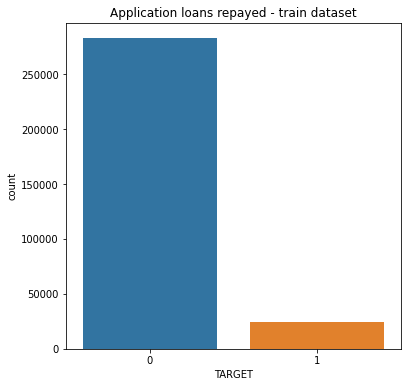

In [ ]:
plt.figure(figsize = (6,6))
sns.countplot(application_train["TARGET"])
plt.title('Application loans repayed - train dataset')
plt.savefig('Application_loans_repayed_train_dataset.jpg')

In [ ]:
percent = application_train["TARGET"].value_counts()/len(application_train["TARGET"])*100
percent

0    91.927118
1     8.072882
Name: TARGET, dtype: float64

#### Observations:
1. The data is imbalanced (91.9%(Loan repayed-0) and 8.07%(Loan not repayed-1)) and we need to handle this problem.

# Explore the data

##  1) Application data

In [ ]:
#creating a function to plot stats of selected feature with target column

def plot_stats(feature,label_rotation=False,horizontal_layout=True):
    temp = application_train[feature].value_counts()
    df1 = pd.DataFrame({feature: temp.index,'Number of contracts': temp.values})

    # Calculate the percentage of target=1 per category value
    cat_perc = application_train[[feature, 'TARGET']].groupby([feature],as_index=False).mean()
    cat_perc.sort_values(by='TARGET', ascending=False, inplace=True)

    if(horizontal_layout):
        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,6))
    else:
        fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(12,14))
    sns.set_color_codes("pastel")
    s = sns.barplot(ax=ax1, x = feature, y="Number of contracts",data=df1)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)

    s = sns.barplot(ax=ax2, x = feature, y='TARGET', order=cat_perc[feature], data=cat_perc)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)
    plt.ylabel('Percent of target with value 1 [%]', fontsize=10)
    plt.savefig(feature)
    plt.tick_params(axis='both', which='major', labelsize=10)

    plt.show();

In [ ]:
#creating a function to calculate the percentage of a particular feature
def percent(feature):
    percent = application_train[feature].value_counts()/len(application_train[feature])*100
    return percent

In [ ]:
#creating a function to calculate the percentage of a particular feature w.r.t to the target column
def tar_percent(feature):
    tar_percent = application_train[[feature, 'TARGET']].groupby([feature],as_index=True).mean()
    tar_percent = tar_percent.sort_values(by=['TARGET'],ascending = False)
    return tar_percent*100

In [ ]:
# Plot distribution of one feature
def plot_distribution(feature,color):
    plt.figure(figsize=(10,6))
    plt.title("Distribution of %s" % feature)
    sns.distplot(application_train[feature].dropna(),color=color, kde=True,bins=100)
    plt.savefig(feature)
    plt.show()

In [ ]:
# Plot distribution of multiple features, with TARGET = 1/0 on the same graph
def plot_distribution_comp(var,nrow=2):

    i = 0
    t1 = application_train.loc[application_train['TARGET'] != 0]
    t0 = application_train.loc[application_train['TARGET'] == 0]

    sns.set_style('whitegrid')
    plt.figure()
    fig, ax = plt.subplots(nrow,2,figsize=(12,6*nrow))

    for feature in var:
        i += 1
        plt.subplot(nrow,2,i)
        sns.kdeplot(t1[feature], bw=0.5,label="TARGET = 1")
        sns.kdeplot(t0[feature], bw=0.5,label="TARGET = 0")
        plt.ylabel('Density plot', fontsize=12)
        plt.xlabel(feature, fontsize=12)
        locs, labels = plt.xticks()
        plt.tick_params(axis='both', which='major', labelsize=12)
    plt.savefig(feature)
    plt.show();

### Loan types

#### Let's see the type of the loans taken and also, on a separate plot, the percent of the loans (by type of the loan) with TARGET value 1 (not returned loan).

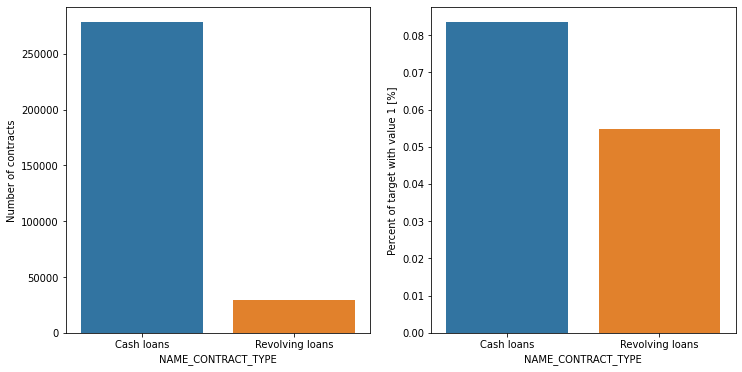

In [ ]:
plot_stats('NAME_CONTRACT_TYPE')


In [ ]:
percent('NAME_CONTRACT_TYPE')

Cash loans         90.478715
Revolving loans     9.521285
Name: NAME_CONTRACT_TYPE, dtype: float64

In [ ]:
tar_percent('NAME_CONTRACT_TYPE')

,TARGET
NAME_CONTRACT_TYPE,
Cash loans,8.345913
Revolving loans,5.478329


#### Contract type Revolving loans are just a small fraction (10%) from the total number of loans; in the same time, a larger amount of Revolving loans, comparing with their frequency, are not repaid.

### Client gender

#### Let's see the gender of the clients and also, on a separate plot, the percent of the loans (by client gender) with TARGET value 1 (not returned loan).

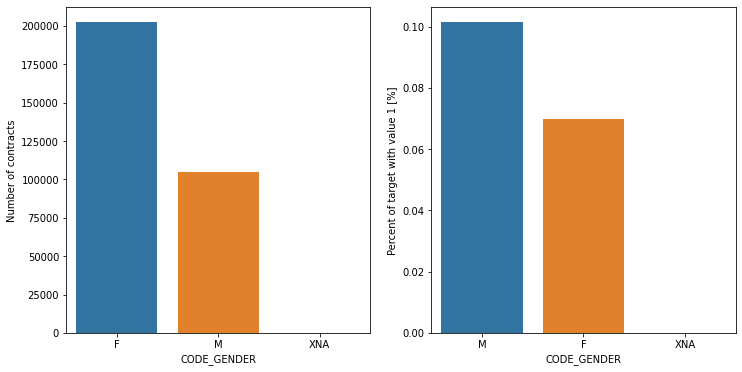

In [ ]:
plot_stats('CODE_GENDER')

In [ ]:
percent('CODE_GENDER')

F      65.834393
M      34.164306
XNA     0.001301
Name: CODE_GENDER, dtype: float64

In [ ]:
tar_percent('CODE_GENDER')

,TARGET
CODE_GENDER,
M,10.141920
F,6.999328
XNA,0.000000


#### The number of female clients is almost double the number of male clients. Looking to the percent of defaulted credits, males have a higher chance of not returning their loans (10%), comparing with women (7%).

### Flag own car and flag own real estate

#### Let's inspect the flags that tell us if a client owns a car or real estate and, on separate plots, the percent of the loans value of these flags) with TARGET value 1 (not returned loan).

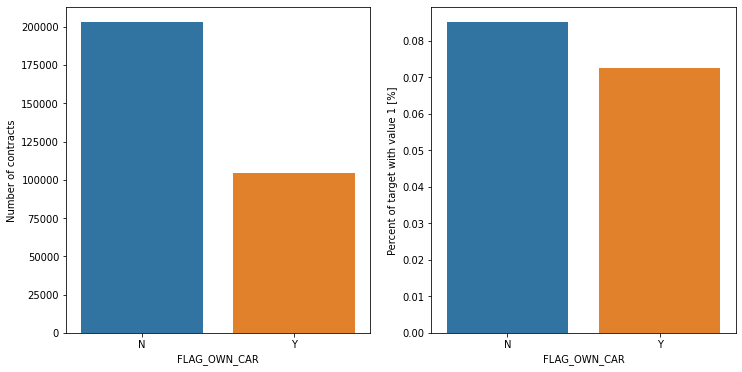

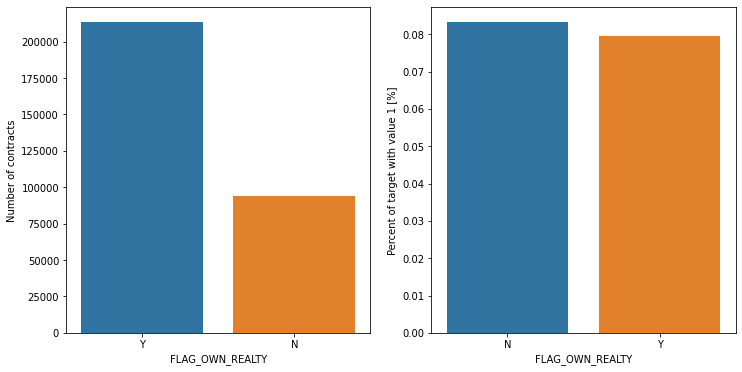

In [ ]:
plot_stats('FLAG_OWN_CAR')
plot_stats('FLAG_OWN_REALTY')

In [ ]:
percent('FLAG_OWN_CAR')

N    65.989184
Y    34.010816
Name: FLAG_OWN_CAR, dtype: float64

In [ ]:
tar_percent('FLAG_OWN_CAR')

,TARGET
FLAG_OWN_CAR,
N,8.500227
Y,7.243730


In [ ]:
percent('FLAG_OWN_REALTY')

Y    69.367275
N    30.632725
Name: FLAG_OWN_REALTY, dtype: float64

In [ ]:
tar_percent('FLAG_OWN_REALTY')

,TARGET
FLAG_OWN_REALTY,
N,8.324929
Y,7.961577


#### The clients that owns a car are almost a half of the ones that doesn't own one. The clients that owns a car are less likely to not repay a car that the ones that own. Both categories have not-repayment rates around 8%.

The clients that owns real estate are more than double of the ones that doesn't own. Both categories (owning real estate or not owning) have not-repayment rates less than 8%.

### Family status of client

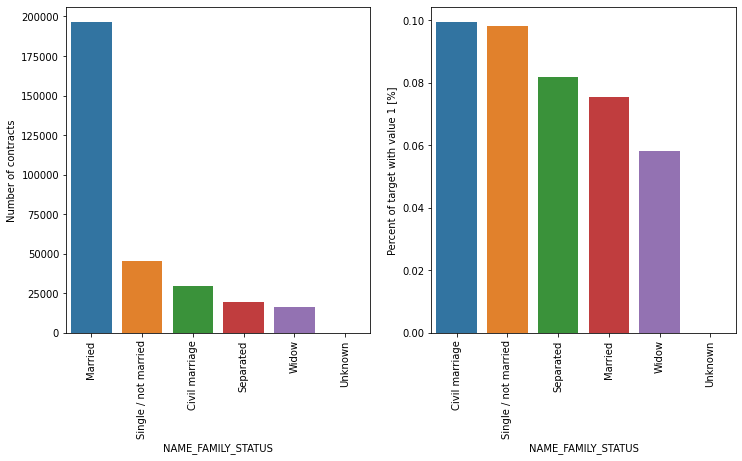

In [ ]:
plot_stats('NAME_FAMILY_STATUS',True,True)

In [ ]:
percent('NAME_FAMILY_STATUS')

Married                 63.878040
Single / not married    14.778008
Civil marriage           9.682580
Separated                6.429038
Widow                    5.231683
Unknown                  0.000650
Name: NAME_FAMILY_STATUS, dtype: float64

In [ ]:
tar_percent('NAME_FAMILY_STATUS')

,TARGET
NAME_FAMILY_STATUS,
Civil marriage,9.944584
Single / not married,9.807675
Separated,8.194234
Married,7.559868
Widow,5.824217
Unknown,0.000000


#### Most of clients are married, followed by Single/not married and civil marriage.

In terms of percentage of not repayment of loan, Civil marriage has the highest percent of not repayment (10%), with Widow the lowest (exception being Unknown).

### Number of children

#### Let's see what is the distribution of the number of children of the clients.

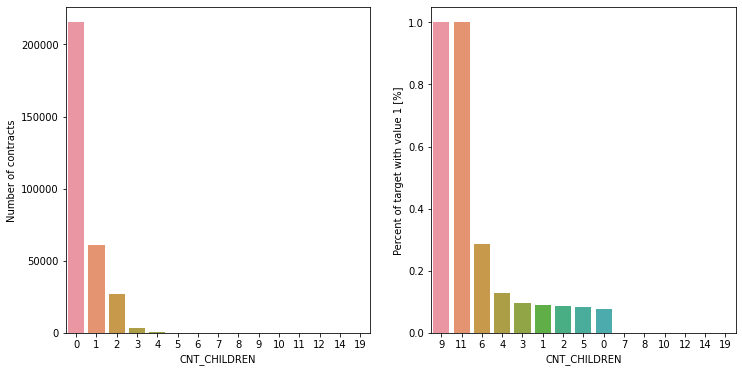

In [ ]:
plot_stats('CNT_CHILDREN')

In [ ]:
percent('CNT_CHILDREN')

0     70.036844
1     19.875387
2      8.698551
3      1.208737
4      0.139507
5      0.027316
6      0.006829
7      0.002276
14     0.000976
19     0.000650
12     0.000650
10     0.000650
9      0.000650
8      0.000650
11     0.000325
Name: CNT_CHILDREN, dtype: float64

In [ ]:
tar_percent('CNT_CHILDREN')

,TARGET
CNT_CHILDREN,
9,100.000000
11,100.000000
6,28.571429
4,12.820513
3,9.631423
1,8.923575
2,8.721821
5,8.333333
0,7.711809


#### Most of the clients taking a loan have no children. The number of loans associated with the clients with one children are 4 times smaller, the number of loans associated with the clients with two children are 8 times smaller; clients with 3, 4 or more children are much more rare.

As for repayment, clients with no children, 1, 2, 3, and 5 children have percents of no repayment around the average (10%). The clients with 4 and 6 children are above average in terms of percent of not paid back loans (over 25% for families with 6 children).

As for clients with 9 or 11 children, the percent of loans not repaid is 100%.

### Number of family members of client

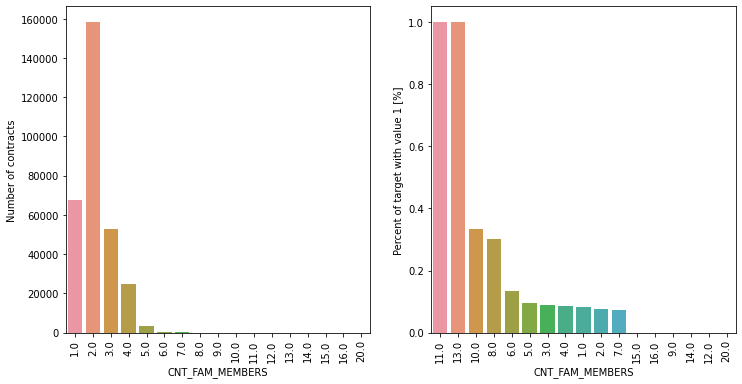

In [ ]:
plot_stats('CNT_FAM_MEMBERS',True)

In [ ]:
percent('CNT_FAM_MEMBERS')

2.0     51.496369
1.0     22.063276
3.0     17.105404
4.0      8.031257
5.0      1.131016
6.0      0.132678
7.0      0.026341
8.0      0.006504
9.0      0.001951
10.0     0.000976
14.0     0.000650
16.0     0.000650
12.0     0.000650
20.0     0.000650
11.0     0.000325
13.0     0.000325
15.0     0.000325
Name: CNT_FAM_MEMBERS, dtype: float64

In [ ]:
tar_percent('CNT_FAM_MEMBERS')

,TARGET
CNT_FAM_MEMBERS,
11.0,100.000000
13.0,100.000000
10.0,33.333333
8.0,30.000000
6.0,13.480392
5.0,9.401955
3.0,8.760290
4.0,8.648824
1.0,8.364408


#### Clients with family members of 2 are most numerous, followed by 1 (single persons), 3 (families with one child) and 4.

Clients with family size of 11 and 13 have 100% not repayment rate. Other families with 10 or 8 members have percents of not repayment of loans over 30%. Families with 6 or less members have repayment rates close to the 10% average.

### Income type of client

#### Let's investigate the numbers of clients with different income type. As well, let's see the percent of not returned loans per income type of applicants.

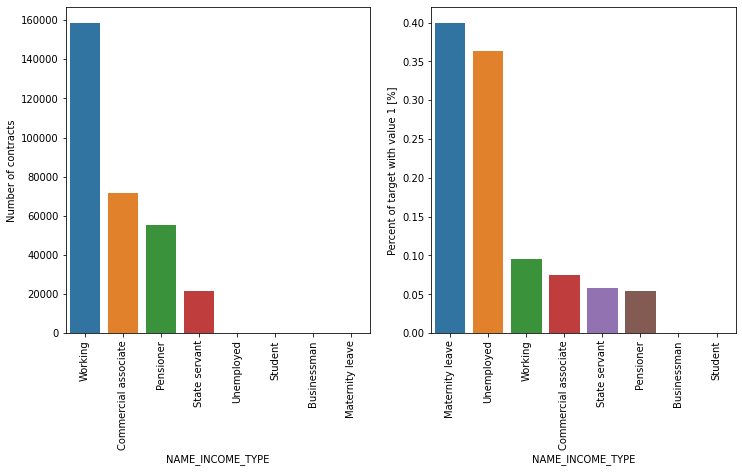

In [ ]:
plot_stats('NAME_INCOME_TYPE',True)

In [ ]:
percent('NAME_INCOME_TYPE')

Working                 51.631974
Commercial associate    23.289248
Pensioner               18.003258
State servant            7.057634
Unemployed               0.007154
Student                  0.005853
Businessman              0.003252
Maternity leave          0.001626
Name: NAME_INCOME_TYPE, dtype: float64

In [ ]:
tar_percent('NAME_INCOME_TYPE')

,TARGET
NAME_INCOME_TYPE,
Maternity leave,40.000000
Unemployed,36.363636
Working,9.588472
Commercial associate,7.484257
State servant,5.754965
Pensioner,5.386366
Businessman,0.000000
Student,0.000000


#### Most of applicants for loans are income from Working, followed by Commercial associate, Pensioner and State servant.

The applicants with the type of income Maternity leave have almost 40% ratio of not returning loans, followed by Unemployed (37%). The rest of types of incomes are under the average of 10% for not returning loans.

### Ocupation of client

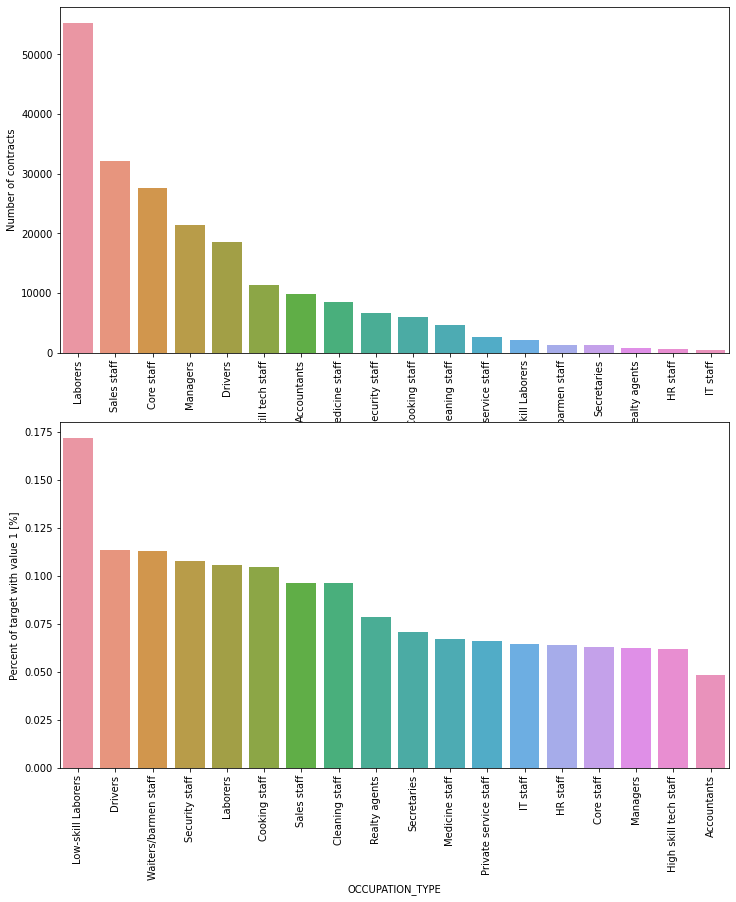

In [ ]:
plot_stats('OCCUPATION_TYPE',True, False)

In [ ]:
percent('OCCUPATION_TYPE')

Laborers                 17.946025
Sales staff              10.439301
Core staff                8.965533
Managers                  6.949670
Drivers                   6.049540
High skill tech staff     3.700681
Accountants               3.191105
Medicine staff            2.776161
Security staff            2.185613
Cooking staff             1.933589
Cleaning staff            1.513117
Private service staff     0.862408
Low-skill Laborers        0.680626
Waiters/barmen staff      0.438358
Secretaries               0.424375
Realty agents             0.244219
HR staff                  0.183083
IT staff                  0.171051
Name: OCCUPATION_TYPE, dtype: float64

In [ ]:
tar_percent('OCCUPATION_TYPE')

,TARGET
OCCUPATION_TYPE,
Low-skill Laborers,17.152413
Drivers,11.326130
Waiters/barmen staff,11.275964
Security staff,10.742449
Laborers,10.578770
Cooking staff,10.443996
Sales staff,9.631799
Cleaning staff,9.606705
Realty agents,7.856192


#### Most of the loans are taken by Laborers, followed by Sales staff. IT staff take the lowest amount of loans.

The category with highest percent of not repaid loans are Low-skill Laborers (above 17%), followed by Drivers and Waiters/barmen staff, Security staff, Laborers and Cooking staff.

### Organization type

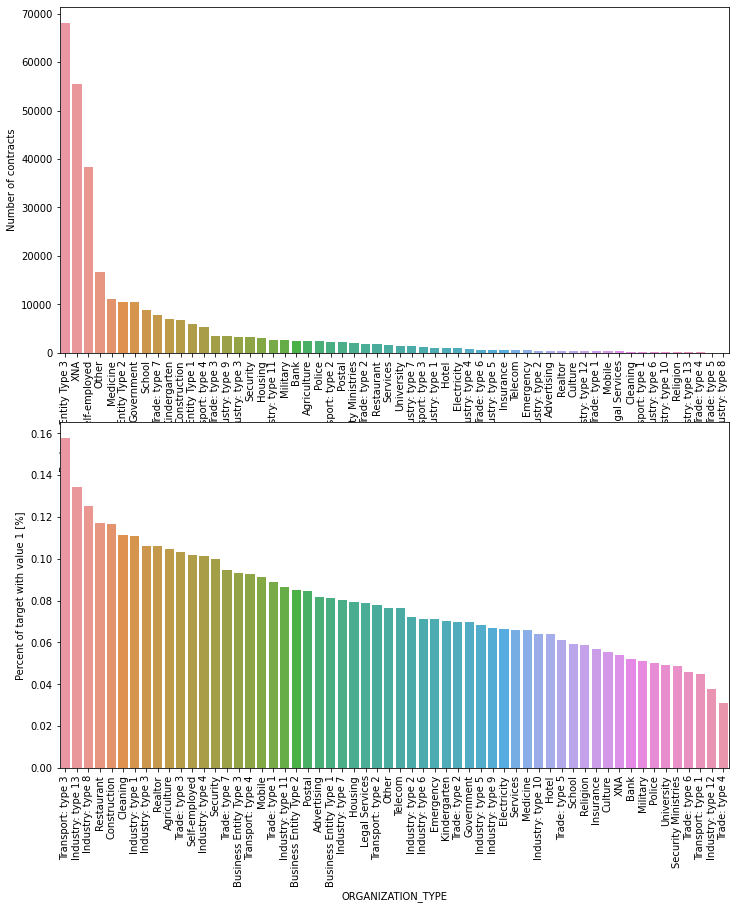

In [ ]:
plot_stats('ORGANIZATION_TYPE',True, False)

In [ ]:
percent('ORGANIZATION_TYPE')

Business Entity Type 3    22.110429
XNA                       18.007161
Self-employed             12.491260
Other                      5.425172
Medicine                   3.639870
Business Entity Type 2     3.431747
Government                 3.383294
School                     2.891929
Trade: type 7              2.546576
Kindergarten               2.237318
Construction               2.185613
Business Entity Type 1     1.945947
Transport: type 4          1.755384
Trade: type 3              1.135569
Industry: type 9           1.095245
Industry: type 3           1.065978
Security                   1.055897
Housing                    0.961917
Industry: type 11          0.879318
Military                   0.856555
Bank                       0.815255
Agriculture                0.798020
Police                     0.761274
Transport: type 2          0.716722
Postal                     0.701438
Security Ministries        0.641928
Trade: type 2              0.617864
Restaurant                 0

In [ ]:
tar_percent('ORGANIZATION_TYPE')

,TARGET
ORGANIZATION_TYPE,
Transport: type 3,15.754002
Industry: type 13,13.432836
Industry: type 8,12.500000
Restaurant,11.706240
Construction,11.679810
Cleaning,11.153846
Industry: type 1,11.068335
Industry: type 3,10.616229
Realtor,10.606061


#### Oraganizations with highest percent of loans not repaid are Transport: type 3 (16%), Industry: type 13 (13.5%), Industry: type 8 (12.5%) and Restaurant (less than 12%).

#### Education type of the client

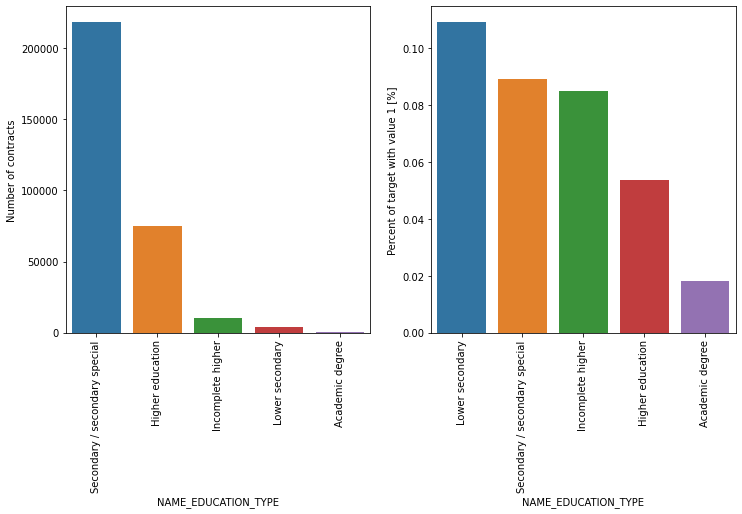

In [ ]:
plot_stats('NAME_EDUCATION_TYPE',True)

In [ ]:
percent('NAME_EDUCATION_TYPE')

Secondary / secondary special    71.018923
Higher education                 24.344820
Incomplete higher                 3.341994
Lower secondary                   1.240931
Academic degree                   0.053331
Name: NAME_EDUCATION_TYPE, dtype: float64

In [ ]:
tar_percent('NAME_EDUCATION_TYPE')

,TARGET
NAME_EDUCATION_TYPE,
Lower secondary,10.927673
Secondary / secondary special,8.939929
Incomplete higher,8.484966
Higher education,5.355115
Academic degree,1.829268


#### Majority of the clients have Secondary / secondary special education, followed by clients with Higher education. Only a very small number having an academic degree.

The Lower secondary category, although rare, have the largest rate of not returning the loan (11%). The people with Academic degree have less than 2% not-repayment rate.

### Type of the housing of client

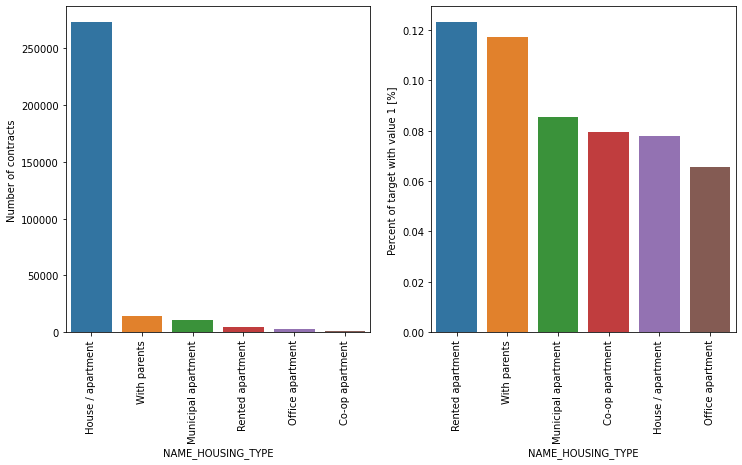

In [ ]:
plot_stats('NAME_HOUSING_TYPE',True)

In [ ]:
percent('NAME_HOUSING_TYPE')

House / apartment      88.734387
With parents            4.825844
Municipal apartment     3.636618
Rented apartment        1.587260
Office apartment        0.851026
Co-op apartment         0.364865
Name: NAME_HOUSING_TYPE, dtype: float64

In [ ]:
tar_percent('NAME_HOUSING_TYPE')

,TARGET
NAME_HOUSING_TYPE,
Rented apartment,12.313051
With parents,11.698113
Municipal apartment,8.539748
Co-op apartment,7.932264
House / apartment,7.795711
Office apartment,6.572411


#### Over 250,000 applicants for credits registered their housing as House/apartment. Following categories have a very small number of clients (With parents, Municipal appartment).

From these categories, Rented apartment and With parents have higher than 10% not-repayment rate.

### Total income distribution

#### Let's plot the distribution of total income for the clients.

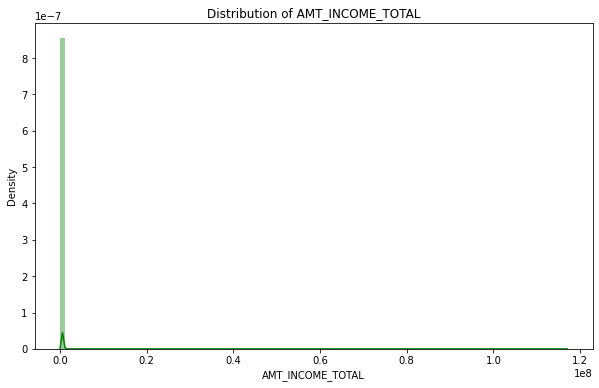

In [ ]:
plot_distribution('AMT_INCOME_TOTAL','green')

### Credit distribution

#### Let's plot the credit distribution.

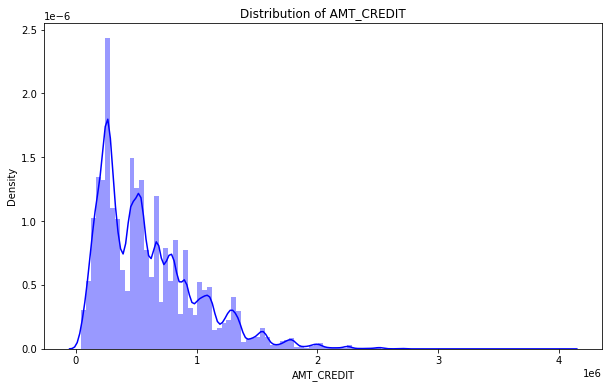

In [ ]:
plot_distribution('AMT_CREDIT','blue')

### Annuity distribution

#### Let's plot the annuity distribution.

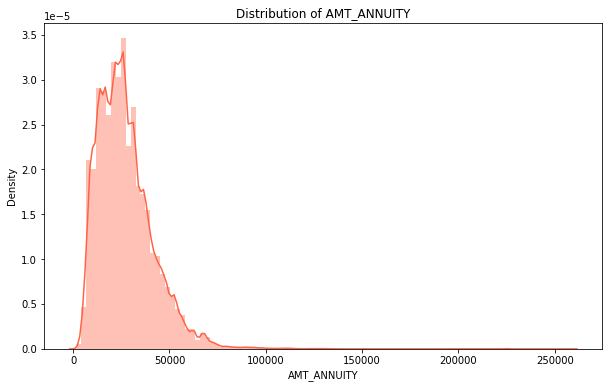

In [ ]:
plot_distribution('AMT_ANNUITY','tomato')

### Goods price

#### Let's plot the good price distribution.

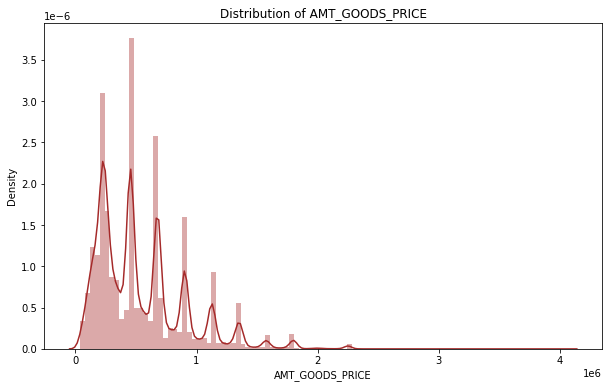

In [ ]:
plot_distribution('AMT_GOODS_PRICE','brown')

### Days from birth distribution

#### Let's plot the distribution number of days from birth.

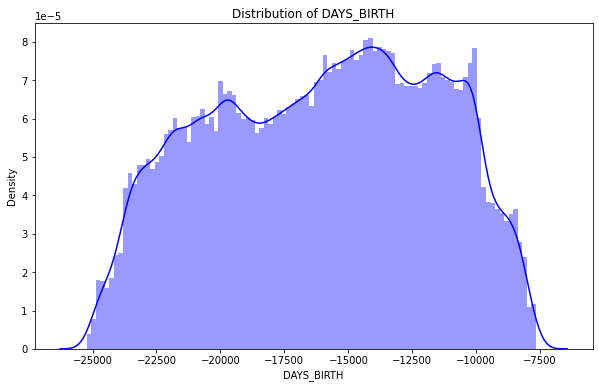

In [ ]:
plot_distribution('DAYS_BIRTH','blue')

#### The negative value means that the date of birth is in the past. The age range is between approximative 20 and 68 years.

### Days employed distribution

#### Let's represent the distribution of number of days employed.

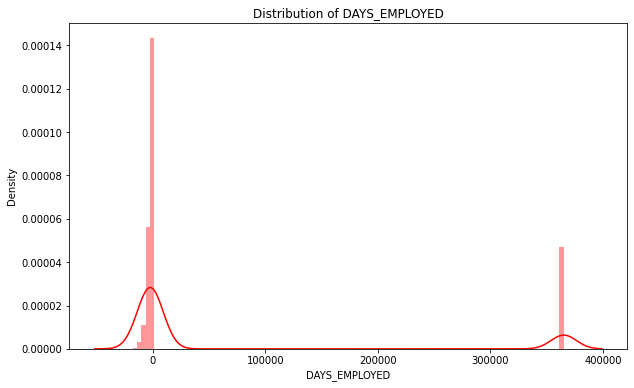

In [ ]:
plot_distribution('DAYS_EMPLOYED','red')

#### The negative values means Days since employed and most probably these negative values means Unemployed. It is not clear what will be the meaning of the very large numbers at the far end (it is not realistic such a large set of people employed more than 100 years).

### Days of registration distribution

#### Let's plot the distribution of DAYS_REGISTRATION.

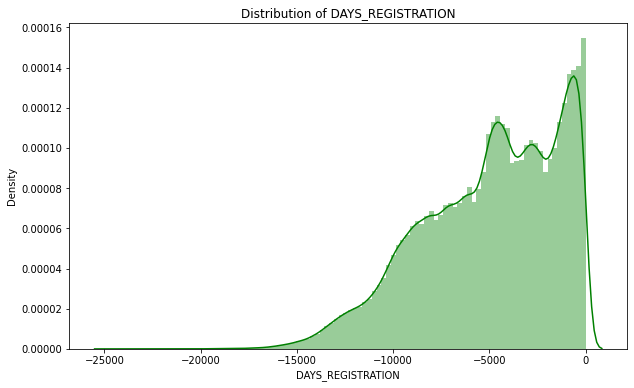

In [ ]:
plot_distribution('DAYS_REGISTRATION','green')

### Days ID publish distribution

#### Let's plot the distribution of DAYS_ID_PUBLISH.

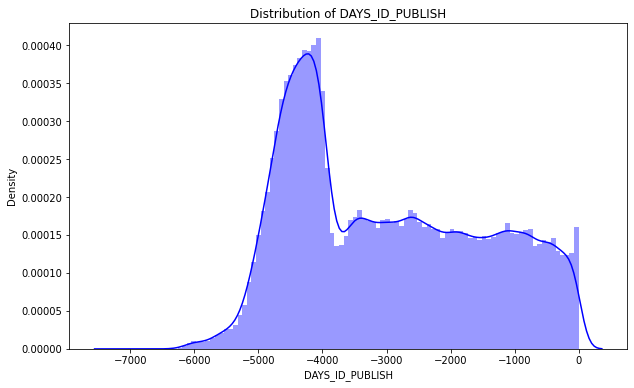

In [ ]:
plot_distribution('DAYS_ID_PUBLISH','blue')

### Comparison of interval values with TARGET = 1 and TARGET = 0

#### Let's compare the distribution of interval values ploted above for values of TARGET = 1 and TARGET = 0

<Figure size 432x288 with 0 Axes>

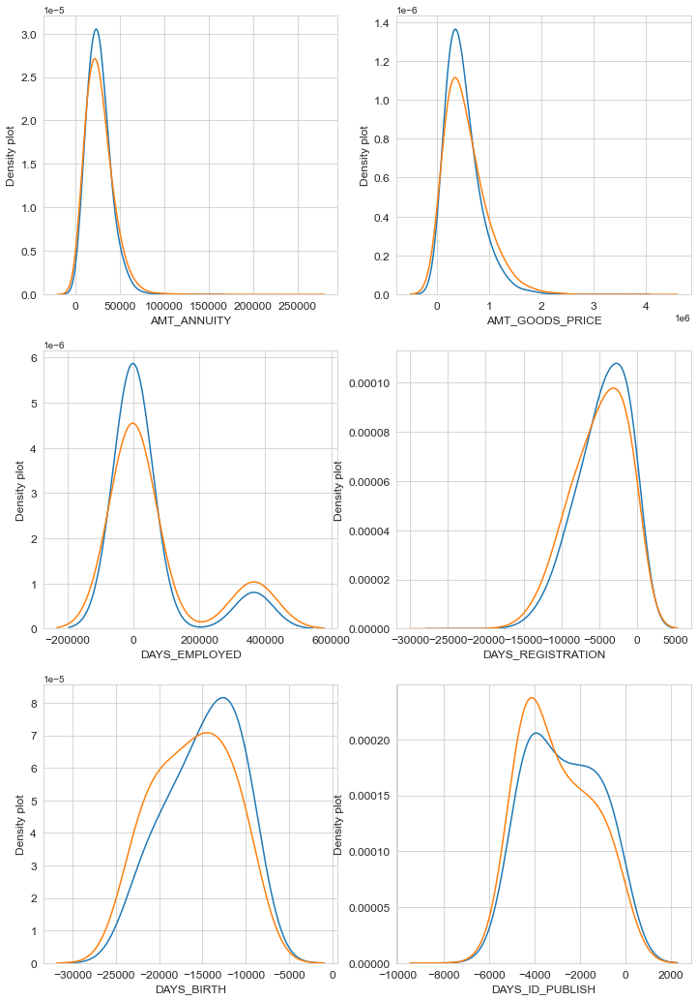

In [ ]:
var = ['AMT_ANNUITY','AMT_GOODS_PRICE','DAYS_EMPLOYED', 'DAYS_REGISTRATION','DAYS_BIRTH','DAYS_ID_PUBLISH']
plot_distribution_comp(var,nrow=3)

### Region registered not live region and not work region

#### Let's represent the values of region registered and not live region and region registered and not work region.

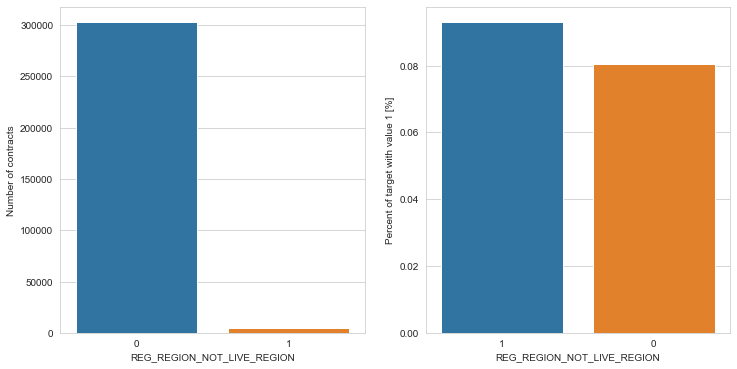

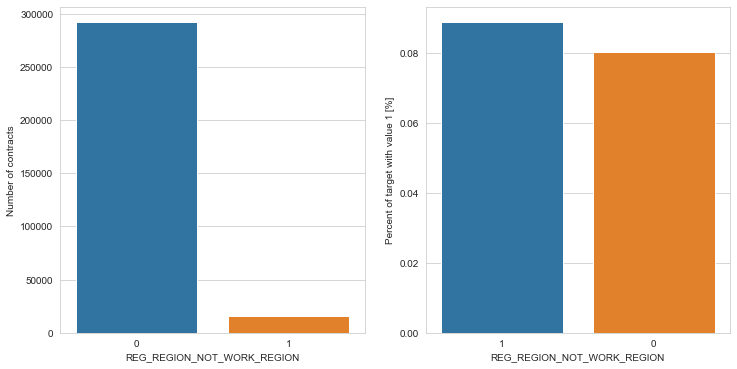

In [ ]:
plot_stats('REG_REGION_NOT_LIVE_REGION')
plot_stats('REG_REGION_NOT_WORK_REGION')

In [ ]:
percent('REG_REGION_NOT_LIVE_REGION')

0    98.485583
1     1.514417
Name: REG_REGION_NOT_LIVE_REGION, dtype: float64

In [ ]:
tar_percent('REG_REGION_NOT_LIVE_REGION')

,TARGET
REG_REGION_NOT_LIVE_REGION,
1,9.297831
0,8.054046


In [ ]:
percent('REG_REGION_NOT_WORK_REGION')

0    94.923108
1     5.076892
Name: REG_REGION_NOT_WORK_REGION, dtype: float64

In [ ]:
tar_percent('REG_REGION_NOT_WORK_REGION')

,TARGET
REG_REGION_NOT_WORK_REGION,
1,8.890597
0,8.029147


#### Very few people are registered in not live or not work region. Generally, the rate of not return is slightly larger for these cases than in the rest (slightly above 8% compared with approx. 8%)

### City registered not live city and not work city

#### Let's represent the values of City registered not live city and not work city.

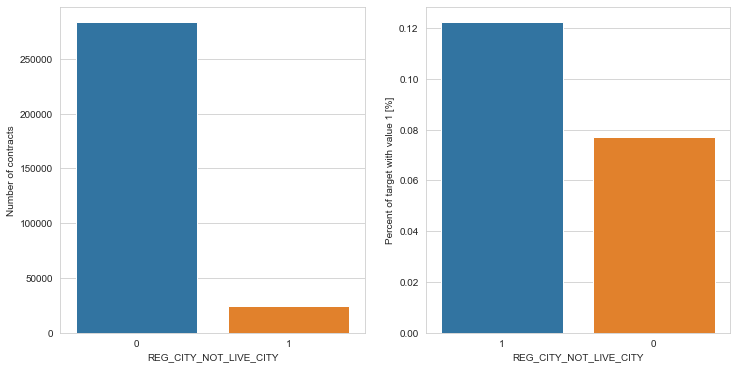

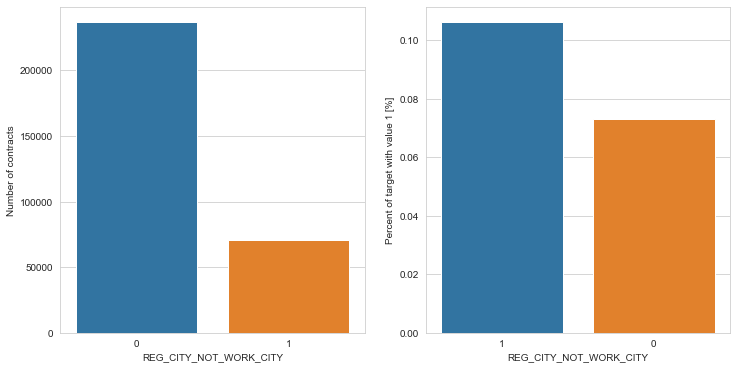

In [ ]:
plot_stats('REG_CITY_NOT_LIVE_CITY')
plot_stats('REG_CITY_NOT_WORK_CITY')

In [ ]:
percent('REG_CITY_NOT_LIVE_CITY')

0    92.182719
1     7.817281
Name: REG_CITY_NOT_LIVE_CITY, dtype: float64

In [ ]:
tar_percent('REG_CITY_NOT_LIVE_CITY')

,TARGET
REG_CITY_NOT_LIVE_CITY,
1,12.225966
0,7.720692


In [ ]:
percent('REG_CITY_NOT_WORK_CITY')

0    76.954646
1    23.045354
Name: REG_CITY_NOT_WORK_CITY, dtype: float64

In [ ]:
tar_percent('REG_CITY_NOT_WORK_CITY')

,TARGET
REG_CITY_NOT_WORK_CITY,
1,10.611427
0,7.312672


#### Generally, much more people register in the city they live or work (a larger number register differently in the working city than living city).

The ones that register in different city than the working or living city are more frequently not-repaying the loans than the ones that register same city (work 11% or live 12%).

##  2) Bureau data

#### Bureau data contains all client's previous credits provided by other financial institutions that were reported to Credit Bureau (for clients who have a loan in the sample). For every loan in the sample, there are as many rows as number of credits the client had in Credit Bureau before the application date. SK_ID_CURR is the key connecting application_train|test data with bureau data.

Let's merge application_train with bureau.

In [ ]:
application_bureau_train = application_train.merge(bureau, left_on='SK_ID_CURR', right_on='SK_ID_CURR', how='inner')

In [ ]:
print('Size of application_bureau_train data', application_bureau_train.shape)

Size of application_bureau_train data (1465325, 138)


#### Let's now analyse application_bureau_train data

In [ ]:
#creating a function to plot stats of selected feature with target column for application bureau train data
def plot_b_stats(feature,label_rotation=False,horizontal_layout=True):
    temp = application_bureau_train[feature].value_counts()
    df1 = pd.DataFrame({feature: temp.index,'Number of contracts': temp.values})

    # Calculate the percentage of target=1 per category value
    cat_perc = application_bureau_train[[feature, 'TARGET']].groupby([feature],as_index=False).mean()
    cat_perc.sort_values(by='TARGET', ascending=False, inplace=True)

    if(horizontal_layout):
        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,6))
    else:
        fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(12,14))
    sns.set_color_codes("pastel")
    s = sns.barplot(ax=ax1, x = feature, y="Number of contracts",data=df1)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)

    s = sns.barplot(ax=ax2, x = feature, y='TARGET', order=cat_perc[feature], data=cat_perc)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)
    plt.ylabel('Percent of target with value 1 [%]', fontsize=10)
    plt.tick_params(axis='both', which='major', labelsize=10)
    plt.savefig(feature)
    plt.show();

In [ ]:
#creating a function to calculate the percentage of a particular feature for application bureau train data
def percent_b(feature):
    percent = application_bureau_train[feature].value_counts()/len(application_bureau_train[feature])*100
    return percent

In [ ]:
#creating a function to calculate the percentage of a particular feature w.r.t to the target column for application bureau train data
def tar_percent_b(feature):
    tar_percent = application_bureau_train[[feature, 'TARGET']].groupby([feature],as_index=True).mean()
    tar_percent = tar_percent.sort_values(by=['TARGET'],ascending = False)
    return tar_percent*100

In [ ]:
# Plot distribution of one feature for application bureau train data
def plot_distribution_b(feature,color):
    plt.figure(figsize=(10,6))
    plt.title("Distribution of %s" % feature)
    sns.distplot(application_bureau_train[feature].dropna(),color=color, kde=True,bins=100)
    plt.savefig(feature)
    plt.show()

In [ ]:
# Plot distribution of multiple features, with TARGET = 1/0 on the same graph for application bureau train data
def plot_distribution_comp_b(var,nrow=2):

    i = 0
    t1 = application_bureau_train.loc[application_bureau_train['TARGET'] != 0]
    t0 = application_bureau_train.loc[application_bureau_train['TARGET'] == 0]

    sns.set_style('whitegrid')
    plt.figure()
    fig, ax = plt.subplots(nrow,2,figsize=(12,6*nrow))

    for feature in var:
        i += 1
        plt.subplot(nrow,2,i)
        sns.kdeplot(t1[feature], bw=0.5,label="TARGET = 1")
        sns.kdeplot(t0[feature], bw=0.5,label="TARGET = 0")
        plt.ylabel('Density plot', fontsize=12)
        plt.xlabel(feature, fontsize=12)
        locs, labels = plt.xticks()
        plt.tick_params(axis='both', which='major', labelsize=12)
    plt.savefig(feature)
    plt.show();

In [ ]:
#creating a function to plot outlier distribution for application bureau train data
def is_outlier(points, thresh=3.5):
    if len(points.shape) == 1:
        points = points[:,None]
        median = np.median(points, axis=0)
        diff = np.sum((points - median)**2, axis=-1)
        diff = np.sqrt(diff)
        med_abs_deviation = np.median(diff)

        modified_z_score = 0.6745 * diff / med_abs_deviation

        return modified_z_score > thresh

def plot_o_distribution_b(feature,color):
    plt.figure(figsize=(10,6))
    plt.title("Distribution of %s" % feature)
    x = application_bureau_train[feature].dropna()
    filtered = x[~is_outlier(x)]
    sns.distplot(filtered,color=color, kde=True,bins=100)
    plt.savefig(feature)
    plt.show()

### Credit status

#### Let's see the credit status distribution. We show first the number of credits per category (could be Closed, Active, Sold and Bad debt).

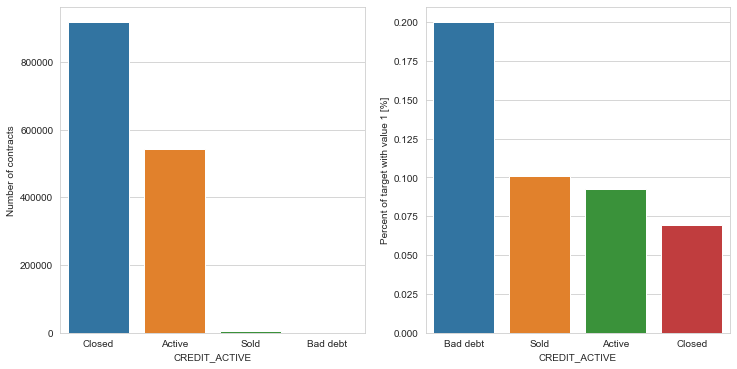

In [ ]:
plot_b_stats('CREDIT_ACTIVE')

In [ ]:
percent_b('CREDIT_ACTIVE')

Closed      62.629997
Active      36.982854
Sold         0.385785
Bad debt     0.001365
Name: CREDIT_ACTIVE, dtype: float64

In [ ]:
tar_percent_b('CREDIT_ACTIVE')

,TARGET
CREDIT_ACTIVE,
Bad debt,20.000000
Sold,10.100831
Active,9.288473
Closed,6.931101


#### Most of the credits registered at the Credit Bureau are in the status Closed (~900K). On the second place are the Active credits ( a bit under 600K). Sold and Bad debt are just a few.

In the same time, as percent having TARGET = 1 from total number per category, clients with credits registered to the Credit Bureau with Bad debt have 20% default on the currrent applications.

Clients with credits Sold, Active and Closed have percent of TARGET == 1 (default credit) equal or less than 10% (10% being the rate overall). The smallest rate of default credit have the clients with credits registered at the Credit Bureau with Closed credits.

That means the former registered credit history (as registered at Credit Bureau) is a strong predictor for the dafault credit, since the percent of applications defaulting with a history of Bad debt is twice as large as for Sold or Active and almost three times larger as for Closed.

### Credit currency

#### Let's check now the number of credits registered at the Credit Bureau with different currencies. Also, let's check procent of defaulting credits (for current applications) per different currencies of credits credits registered at the Credit Bureau in the past for the same client.

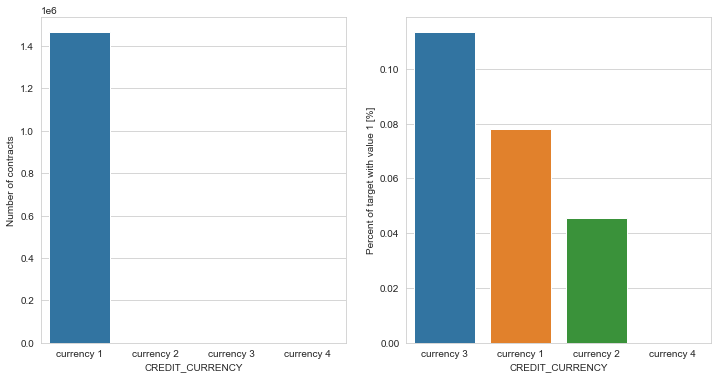

In [ ]:
plot_b_stats('CREDIT_CURRENCY')

In [ ]:
percent_b('CREDIT_CURRENCY')

currency 1    99.915991
currency 2     0.073158
currency 3     0.010237
currency 4     0.000614
Name: CREDIT_CURRENCY, dtype: float64

In [ ]:
tar_percent_b('CREDIT_CURRENCY')

,TARGET
CREDIT_CURRENCY,
currency 3,11.333333
currency 1,7.817394
currency 2,4.570896
currency 4,0.000000


#### Credits are mostly in currency_1.

Depending on the currency, the percent of clients defaulting is quite different. Starting with currency_3, then currency_1 and currency_2, the percent of clients defaulting is 11%, 8% and 5%. Percent of defaulting applications for clients that have credits registered with currency_4 is close to 0.

### Credit type

#### Let's check now the credit types for credits registered at the Credit Bureau

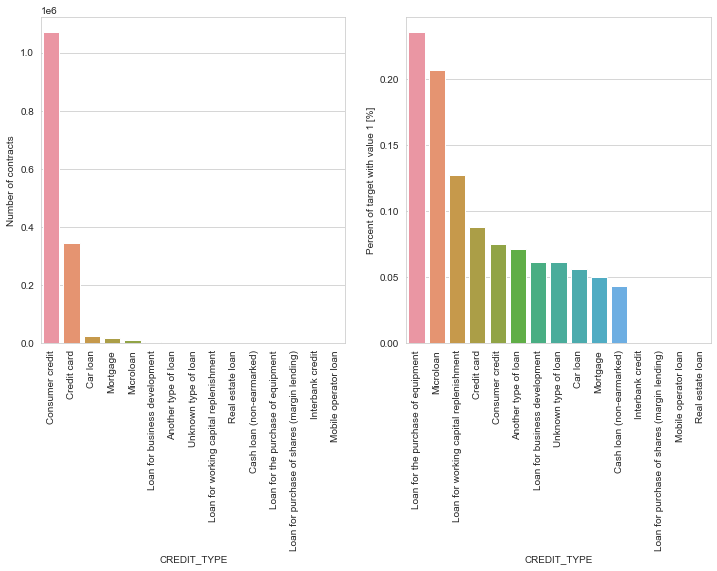

In [ ]:
plot_b_stats('CREDIT_TYPE', True, True)

In [ ]:
percent_b('CREDIT_TYPE')

Consumer credit                                 72.994728
Credit card                                     23.465989
Car loan                                         1.621279
Mortgage                                         1.065088
Microloan                                        0.614539
Loan for business development                    0.117448
Another type of loan                             0.058281
Unknown type of loan                             0.032211
Loan for working capital replenishment           0.025728
Real estate loan                                 0.001570
Cash loan (non-earmarked)                        0.001570
Loan for the purchase of equipment               0.001160
Loan for purchase of shares (margin lending)     0.000273
Interbank credit                                 0.000068
Mobile operator loan                             0.000068
Name: CREDIT_TYPE, dtype: float64

In [ ]:
tar_percent_b('CREDIT_TYPE')

,TARGET
CREDIT_TYPE,
Loan for the purchase of equipment,23.529412
Microloan,20.644087
Loan for working capital replenishment,12.732095
Credit card,8.800854
Consumer credit,7.483662
Another type of loan,7.142857
Loan for business development,6.159210
Unknown type of loan,6.144068
Car loan,5.573094


#### Majority of historical credits registered at the Credit Bureau are Consumer credit and Credit card. Smaller number of credits are Car loan, Mortgage and Microloan.

Looking now to the types of historical credits registered at the Credit Bureau, there are few types with a high percent of current credit defaults, as following:

Loan for the purchase of equipment - with over 20% current credits defaults;
Microloan - with over 20% current credits defaults;
Loan for working capital replenishement - with over 12% current credits defaults.

### Duration of credit (DAYS_CREDIT)

#### Let's check the distribution of number of days for the credit (registered at the Credit bureau).

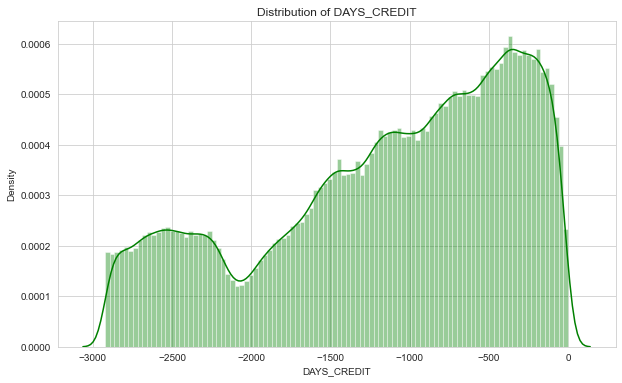

In [ ]:
plot_distribution_b('DAYS_CREDIT','green')

#### The credit duration (in days) is ranging between less than 3000 days (with a local sadle around 2000 days) and with a increasing frequence for shorter number of days - and with a peak around 300 days (or less than one year).

### Credit overdue (CREDIT_DAY_OVERDUE)

#### Let's check the distribution of number of days for the credit overdue (registered at the Credit bureau).

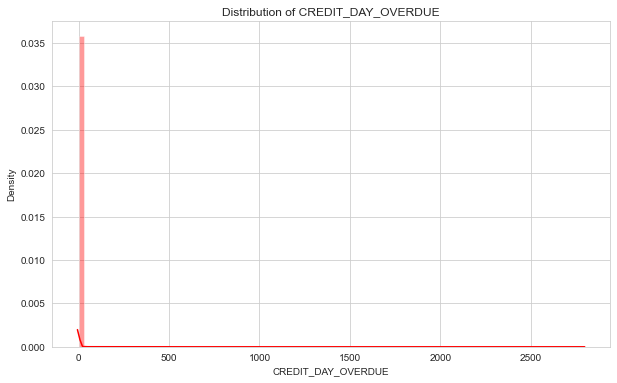

In [ ]:
plot_distribution_b('CREDIT_DAY_OVERDUE','red')

#### Most of the credits have 0 or close to 0 days overdue. The maximum number of credit days overdue is ~3000 days.

### Credit sum (AMT_CREDIT_SUM)

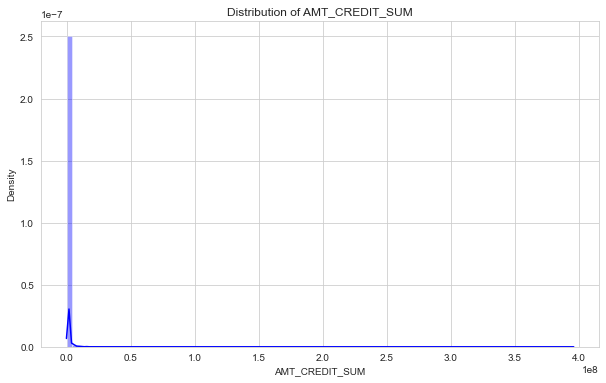

In [ ]:
plot_distribution_b('AMT_CREDIT_SUM','blue')

#### The distribution of the AMT_CREDIT_SUM shows a concentration of the credits for the lower credit sum range.

Let's remove the outliers so that we can see better the distribution around 0.

Let's introduce a function to identify and filter the outliers (with a predefined threshold).

Then, let's also modify the function to display a distribution, this time by using the function to filter the outliers.

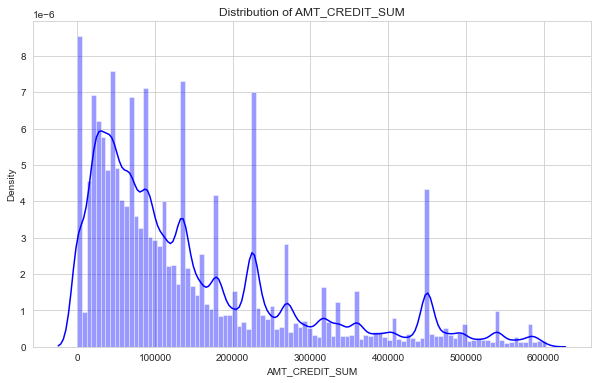

In [ ]:
plot_o_distribution_b('AMT_CREDIT_SUM','blue')

#### We can observe that the distribution function shows several peaks and the maximum concentration of the values is around 20,000 but we also see several other peaks at higher values.

### Credit sum limit (AMT_CREDIT_SUM_LIMIT)

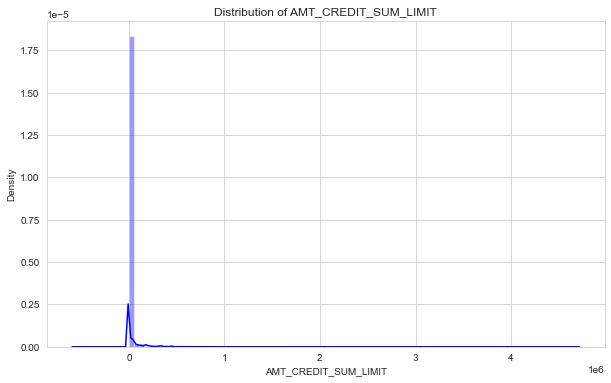

In [ ]:
plot_distribution_b('AMT_CREDIT_SUM_LIMIT','blue')

### Comparison of interval values with TARGET = 1 and TARGET = 0

#### Let's compare the distribution of interval values ploted above for values of TARGET = 1 and TARGET = 0

<Figure size 432x288 with 0 Axes>

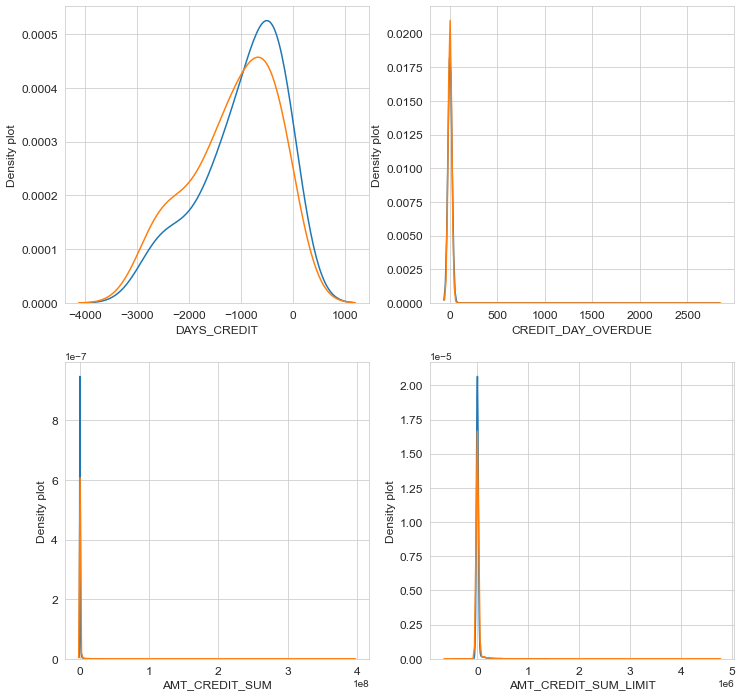

In [ ]:
var = ['DAYS_CREDIT','CREDIT_DAY_OVERDUE','AMT_CREDIT_SUM','AMT_CREDIT_SUM_LIMIT']

plot_distribution_comp_b(var, nrow=2)

##  3) Previous application data

#### The dataframe previous_application contains information about all previous applications for Home Credit loans of clients who have loans in the sample. There is one row for each previous application related to loans in our data sample. SK_ID_CURR is the key connecting application_train|test data with previous_application data.

Let's merge application_train with previous_application.

In [ ]:
application_prev_train = application_train.merge(previous_application, left_on='SK_ID_CURR', right_on='SK_ID_CURR', how='inner')

In [ ]:
print('Size of application_prev_train data', application_prev_train.shape)

Size of application_prev_train data (1413701, 158)


#### Let's now analyse application_prev_train data

In [ ]:
#creating a function to plot stats of selected feature with target column for application prev train data
def plot_stats_p(feature,label_rotation=False,horizontal_layout=True):
    temp = application_prev_train[feature].value_counts()
    df1 = pd.DataFrame({feature: temp.index,'Number of contracts': temp.values})

    # Calculate the percentage of target=1 per category value
    cat_perc = application_prev_train[[feature, 'TARGET']].groupby([feature],as_index=False).mean()
    cat_perc.sort_values(by='TARGET', ascending=False, inplace=True)

    if(horizontal_layout):
        fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12,6))
    else:
        fig, (ax1, ax2) = plt.subplots(nrows=2, figsize=(12,14))
    sns.set_color_codes("pastel")
    s = sns.barplot(ax=ax1, x = feature, y="Number of contracts",data=df1)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)

    s = sns.barplot(ax=ax2, x = feature, y='TARGET', order=cat_perc[feature], data=cat_perc)
    if(label_rotation):
        s.set_xticklabels(s.get_xticklabels(),rotation=90)
    plt.ylabel('Percent of target with value 1 [%]', fontsize=10)
    plt.tick_params(axis='both', which='major', labelsize=10)
    plt.savefig(feature)
    plt.show();

In [ ]:
#creating a function to calculate the percentage of a particular feature for application prev train data
def percent_p(feature):
    percent = application_prev_train[feature].value_counts()/len(application_prev_train[feature])*100
    return percent

In [ ]:
#creating a function to calculate the percentage of a particular feature w.r.t to the target column for application prev train data
def tar_percent_p(feature):
    tar_percent = application_prev_train[[feature, 'TARGET']].groupby([feature],as_index=True).mean()
    tar_percent = tar_percent.sort_values(by=['TARGET'],ascending = False)
    return tar_percent*100

### Contract type

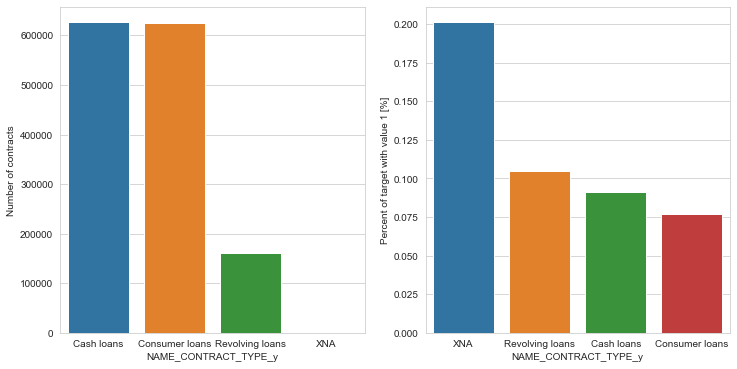

In [ ]:
plot_stats_p('NAME_CONTRACT_TYPE_y')

In [ ]:
percent_p('NAME_CONTRACT_TYPE_y')

Cash loans         44.334976
Consumer loans     44.228306
Revolving loans    11.414578
XNA                 0.022140
Name: NAME_CONTRACT_TYPE_y, dtype: float64

In [ ]:
tar_percent_p('NAME_CONTRACT_TYPE_y')

,TARGET
NAME_CONTRACT_TYPE_y,
XNA,20.127796
Revolving loans,10.468618
Cash loans,9.125763
Consumer loans,7.709962


#### There are three types of contract in the previous application data: Cash loans, Consumer loans, Revolving loans. Cash loans and Consumer loans are almost the same number (~600K) whilst Revolving loans are ~150K.

The percent of defauls loans for clients with previous applications is different for the type of previous applications contracts, decreasing from ~10% for Revolving loans, then ~ 9.5% for Cash loans and ~8% for Consumer loans.

### Cash loan purpose

#### Let's look to the cash loan purpose, in the case of cash loans.

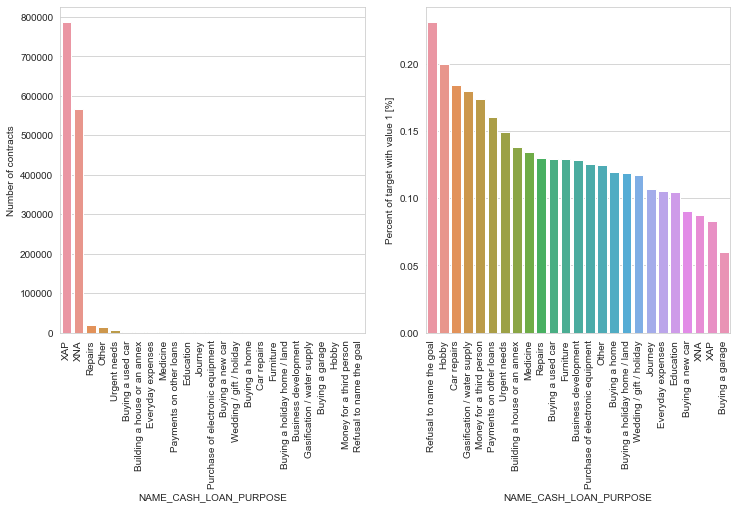

In [ ]:
plot_stats_p('NAME_CASH_LOAN_PURPOSE', True, True)

In [ ]:
percent_p('NAME_CASH_LOAN_PURPOSE')

XAP                                 55.665024
XNA                                 40.132319
Repairs                              1.423002
Other                                0.950130
Urgent needs                         0.511848
Buying a used car                    0.174648
Building a house or an annex         0.165806
Everyday expenses                    0.145151
Medicine                             0.132348
Payments on other loans              0.111268
Education                            0.094362
Journey                              0.073707
Purchase of electronic equipment     0.066068
Buying a new car                     0.062672
Wedding / gift / holiday             0.056660
Buying a home                        0.049586
Car repairs                          0.048879
Furniture                            0.046686
Buying a holiday home / land         0.032751
Business development                 0.025394
Gasification / water supply          0.017755
Buying a garage                   

In [ ]:
tar_percent_p('NAME_CASH_LOAN_PURPOSE')

,TARGET
NAME_CASH_LOAN_PURPOSE,
Refusal to name the goal,23.076923
Hobby,20.000000
Car repairs,18.379161
Gasification / water supply,17.928287
Money for a third person,17.391304
Payments on other loans,16.020343
Urgent needs,14.953013
Building a house or an annex,13.822526
Medicine,13.415286


#### Besides not identifed/not available categories, Repairs, Other, Urgent needs, Buying a used car, Building a house or an annex accounts for the largest number of contracts.

In terms of percent of defaults for current applications in the sample, clients with history of previous applications have largest percents of defaults when in their history are previous applications for cash loans for Refusal to name the goal - 23% (which makes a lot of sense), Hobby (20%), Car repairs (18%).

### Contract status

#### Let's look to the contract status.

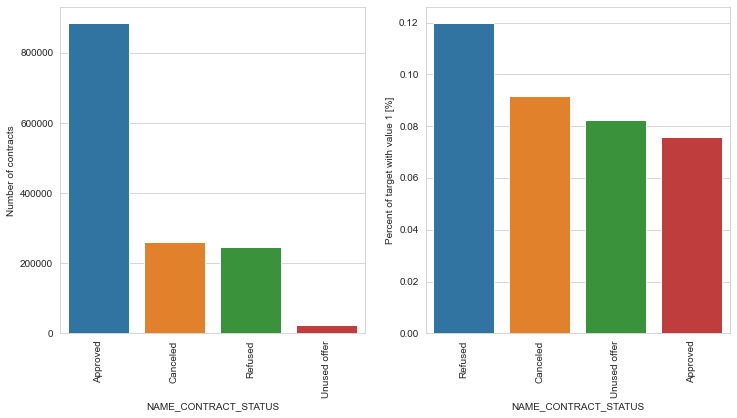

In [ ]:
plot_stats_p('NAME_CONTRACT_STATUS', True, True)

In [ ]:
percent_p('NAME_CONTRACT_STATUS')

Approved        62.679378
Canceled        18.351900
Refused         17.357984
Unused offer     1.610737
Name: NAME_CONTRACT_STATUS, dtype: float64

In [ ]:
tar_percent_p('NAME_CONTRACT_STATUS')

,TARGET
NAME_CONTRACT_STATUS,
Refused,11.996414
Canceled,9.173569
Unused offer,8.251724
Approved,7.588655


#### Most previous applications contract statuses are Approved (850K), Canceled and Refused (240K). There are only ~20K in status Unused offer.

In terms of percent of defaults for current applications in the sample, clients with history of previous applications have largest percents of defaults when in their history contract statuses are Refused (12%), followed by Canceled (9%), Unused offer (~8%) and Approved (lowest percent of defaults in current applictions, with less than 8%).

### Payment type

#### Let's check the payment type.

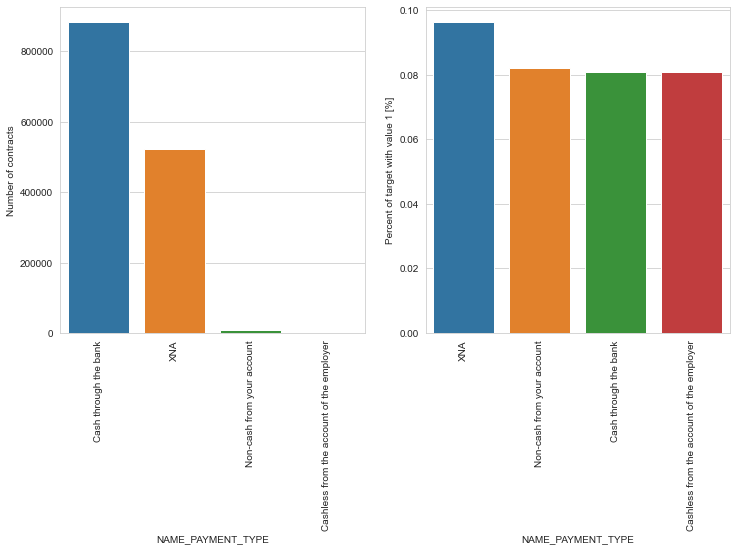

In [ ]:
plot_stats_p('NAME_PAYMENT_TYPE', True, True)

In [ ]:
percent_p('NAME_PAYMENT_TYPE')

Cash through the bank                        62.438946
XNA                                          36.992264
Non-cash from your account                    0.502228
Cashless from the account of the employer     0.066563
Name: NAME_PAYMENT_TYPE, dtype: float64

In [ ]:
tar_percent_p('NAME_PAYMENT_TYPE')

,TARGET
NAME_PAYMENT_TYPE,
XNA,9.622342
Non-cash from your account,8.211268
Cash through the bank,8.086553
Cashless from the account of the employer,8.076514


#### Most of the previous applications were paid with Cash through the bank (850K). Payments using Non-cash from your account or Cashless from the account of the employer are much rare. These three types of payments in previous applications results in allmost the same percent of defaults for current clients (8% each).

### Client type

#### Let's check the client type for previous applications.

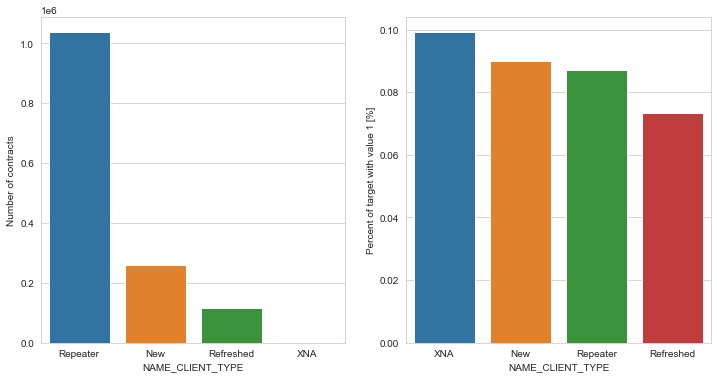

In [ ]:
plot_stats_p('NAME_CLIENT_TYPE')

In [ ]:
percent_p('NAME_CLIENT_TYPE')

Repeater     73.401801
New          18.358903
Refreshed     8.130149
XNA           0.109146
Name: NAME_CLIENT_TYPE, dtype: float64

In [ ]:
tar_percent_p('NAME_CLIENT_TYPE')

,TARGET
NAME_CLIENT_TYPE,
XNA,9.915749
New,8.994760
Repeater,8.714616
Refreshed,7.336257


#### Most of the previous applications have client type Repeater (~1M), just over 200K are New and ~100K are Refreshed.

In terms of default percent for current applications of clients with history of previous applications, current clients with previous applications have values of percent of defaults ranging from from 8.5%, 8.25% and 7% corresponding to client types in the past New, Repeater and Refreshed, respectivelly.

### Application rejected

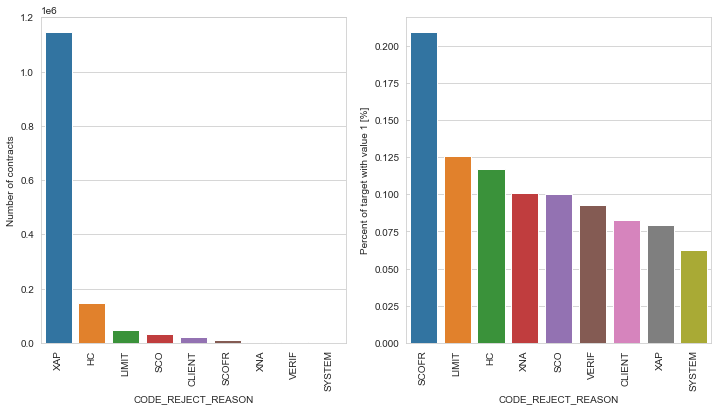

In [ ]:
plot_stats_p("CODE_REJECT_REASON", True, True)

In [ ]:
percent_p("CODE_REJECT_REASON")

XAP       81.030784
HC        10.326370
LIMIT      3.379286
SCO        2.308550
CLIENT     1.610737
SCOFR      0.769257
XNA        0.309684
VERIF      0.217797
SYSTEM     0.047535
Name: CODE_REJECT_REASON, dtype: float64

In [ ]:
tar_percent_p("CODE_REJECT_REASON")

,TARGET
CODE_REJECT_REASON,
SCOFR,20.928736
LIMIT,12.559395
HC,11.734163
XNA,10.095934
SCO,9.998162
VERIF,9.256252
CLIENT,8.251724
XAP,7.947654
SYSTEM,6.250000


#### Top reasons of previous application rejection

### What kind of goods did the client apply

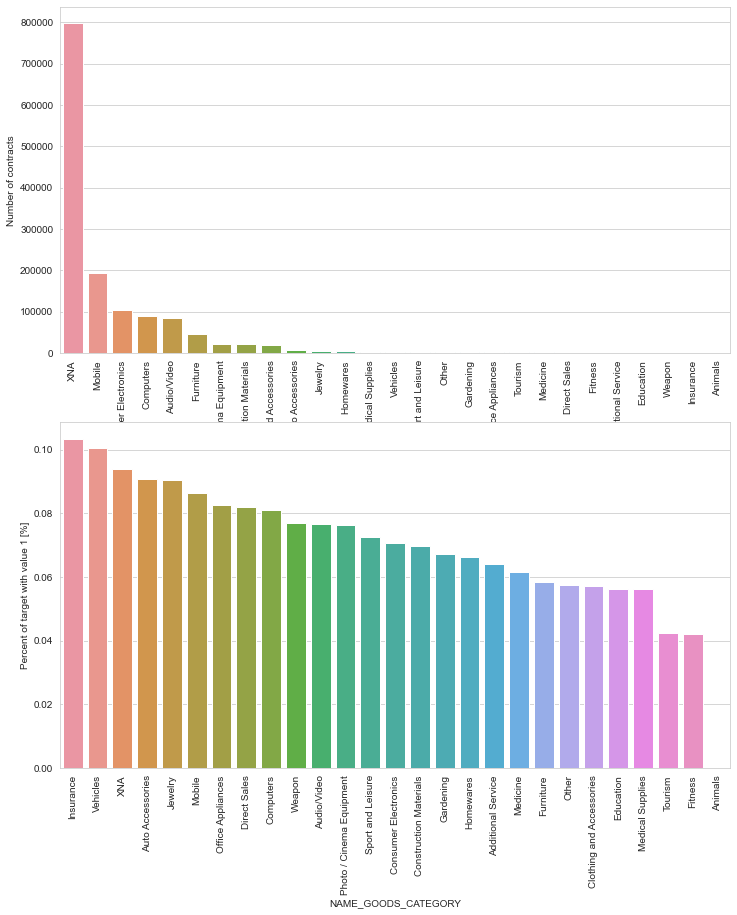

In [ ]:
plot_stats_p("NAME_GOODS_CATEGORY", True, False)

In [ ]:
percent_p("NAME_GOODS_CATEGORY")

XNA                         56.391627
Mobile                      13.704666
Consumer Electronics         7.412105
Computers                    6.360822
Audio/Video                  6.048096
Furniture                    3.214187
Photo / Cinema Equipment     1.535473
Construction Materials       1.510645
Clothing and Accessories     1.385724
Auto Accessories             0.440546
Jewelry                      0.366980
Homewares                    0.304803
Medical Supplies             0.229186
Vehicles                     0.201881
Sport and Leisure            0.179670
Other                        0.165311
Gardening                    0.164250
Office Appliances            0.140412
Tourism                      0.093655
Medicine                     0.092099
Direct Sales                 0.023343
Fitness                      0.011742
Additional Service           0.007710
Education                    0.006296
Weapon                       0.004598
Insurance                    0.004103
Animals     

In [ ]:
tar_percent_p("NAME_GOODS_CATEGORY")

,TARGET
NAME_GOODS_CATEGORY,
Insurance,10.344828
Vehicles,10.056062
XNA,9.385745
Auto Accessories,9.071933
Jewelry,9.040093
Mobile,8.647022
Office Appliances,8.261965
Direct Sales,8.181818
Computers,8.104712


#### List of goods for which the client apply for loan

### Top channels through which they acquired the client

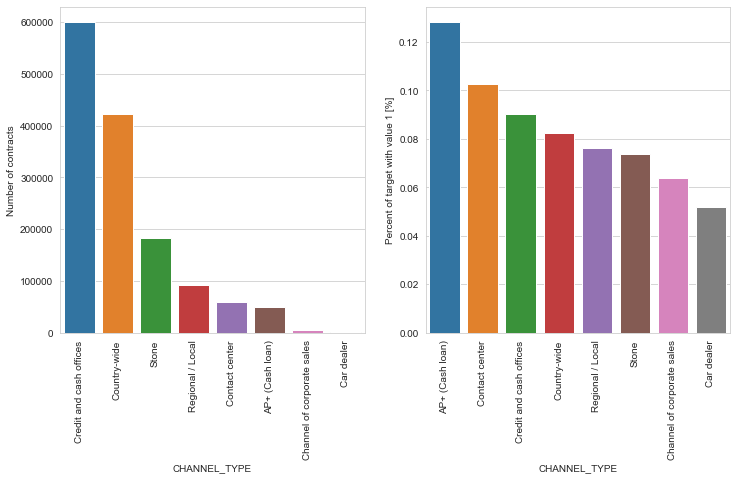

In [ ]:
plot_stats_p("CHANNEL_TYPE", True, True)

In [ ]:
percent_p("CHANNEL_TYPE")

Credit and cash offices       42.465981
Country-wide                  29.925847
Stone                         12.980680
Regional / Local               6.541129
Contact center                 4.165732
AP+ (Cash loan)                3.510219
Channel of corporate sales     0.381693
Car dealer                     0.028719
Name: CHANNEL_TYPE, dtype: float64

In [ ]:
tar_percent_p("CHANNEL_TYPE")

,TARGET
CHANNEL_TYPE,
AP+ (Cash loan),12.826455
Contact center,10.269821
Credit and cash offices,9.011030
Country-wide,8.256000
Regional / Local,7.605545
Stone,7.369706
Channel of corporate sales,6.375093
Car dealer,5.172414


#### Top channels through which they acquired the client on the previous application :
Credit and cash offices : 43 % times

Country_wide : 30 % times

Stone : 13 % times

### Top industry of the seller

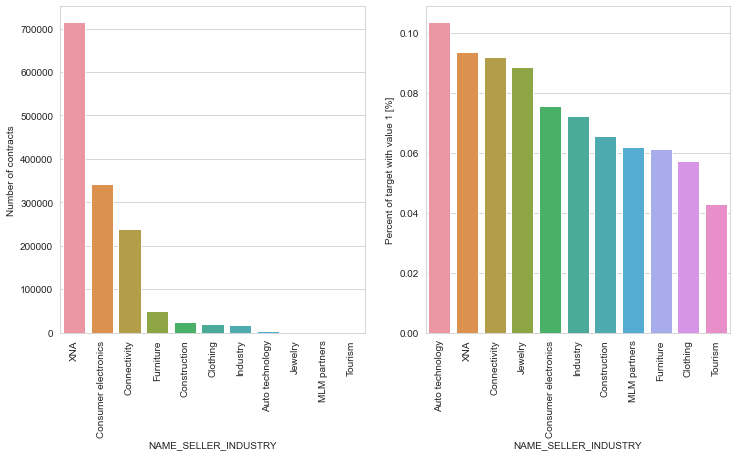

In [ ]:
plot_stats_p("NAME_SELLER_INDUSTRY", True, True)

In [ ]:
percent_p("NAME_SELLER_INDUSTRY")

XNA                     50.599243
Consumer electronics    24.170670
Connectivity            16.860001
Furniture                3.463674
Construction             1.797905
Clothing                 1.407370
Industry                 1.171889
Auto technology          0.288604
Jewelry                  0.149041
MLM partners             0.065148
Tourism                  0.026455
Name: NAME_SELLER_INDUSTRY, dtype: float64

In [ ]:
tar_percent_p("NAME_SELLER_INDUSTRY")

,TARGET
NAME_SELLER_INDUSTRY,
Auto technology,10.367647
XNA,9.355507
Connectivity,9.207048
Jewelry,8.875178
Consumer electronics,7.553387
Industry,7.213135
Construction,6.574340
MLM partners,6.188925
Furniture,6.116489


# Data Preparation

## Feature Engineering of Application data:

In [ ]:
cf.set_config_file(theme='pearl')
(application_train['DAYS_EMPLOYED']).iplot(kind='histogram',
             xTitle = 'Days',bins=50,
             yTitle='Count of applicants in %',
             title='Days before the application the person started current employment')

#### Observations:
1. The data looks strange(we have -1000.66 years(-365243 days) of employment which is impossible) looks like there is data entry error.

In [ ]:
error = application_train[application_train['DAYS_EMPLOYED'] == 365243]
print('The no of errors are :', len(error))
(error['TARGET'].value_counts()/len(error))*100

The no of errors are : 55374


0    94.600354
1     5.399646
Name: TARGET, dtype: float64

In [ ]:
# Create an error flag column
application_train['DAYS_EMPLOYED_ERROR'] = application_train["DAYS_EMPLOYED"] == 365243
# Replace the error values with nan
application_train['DAYS_EMPLOYED'].replace({365243: np.nan}, inplace = True)

In [ ]:
cf.set_config_file(theme='pearl')
(application_train['DAYS_EMPLOYED']/(-365)).iplot(kind='histogram', xTitle = 'Years of Employment',bins=50,
             yTitle='Count of applicants in %',
             title='Years before the application the person started current employment')

In [ ]:
application_train[application_train['DAYS_EMPLOYED']>(-365*2)]['TARGET'].value_counts()/sum(application_train['DAYS_EMPLOYED']>(-365*2))

0    0.887924
1    0.112076
Name: TARGET, dtype: float64

#### Observations:
1. The applicants with less than 2 years of employment are less likely to repay the loan.

In [ ]:
# Flag to represent when Total income is greater than Credit
application_train['INCOME_GT_CREDIT_FLAG'] = application_train['AMT_INCOME_TOTAL'] > application_train['AMT_CREDIT']
# Column to represent Credit Income Percent
application_train['CREDIT_INCOME_PERCENT'] = application_train['AMT_CREDIT'] / application_train['AMT_INCOME_TOTAL']
# Column to represent Annuity Income percent
application_train['ANNUITY_INCOME_PERCENT'] = application_train['AMT_ANNUITY'] / application_train['AMT_INCOME_TOTAL']
# Column to represent Credit Term
application_train['CREDIT_TERM'] = application_train['AMT_CREDIT'] / application_train['AMT_ANNUITY']
# Column to represent Days Employed percent in his life
application_train['DAYS_EMPLOYED_PERCENT'] = application_train['DAYS_EMPLOYED'] / application_train['DAYS_BIRTH']
# Shape of Application data
print('The shape of application data:',application_train.shape)

The shape of application data: (307511, 128)


## Joining Bureau data to Application data:

In [ ]:
# Combining numerical features
grp = bureau.drop(['SK_ID_BUREAU'], axis = 1).groupby(by=['SK_ID_CURR']).mean().reset_index()
grp.columns = ['BUREAU_'+column if column !='SK_ID_CURR' else column for column in grp.columns]
application_bureau = application_train.merge(grp, on='SK_ID_CURR', how='left')
application_bureau.update(application_bureau[grp.columns].fillna(0))
# Combining categorical features
bureau_categorical = pd.get_dummies(bureau.select_dtypes('object'))
bureau_categorical['SK_ID_CURR'] = bureau['SK_ID_CURR']
grp = bureau_categorical.groupby(by = ['SK_ID_CURR']).mean().reset_index()
grp.columns = ['BUREAU_'+column if column !='SK_ID_CURR' else column for column in grp.columns]
application_bureau = application_bureau.merge(grp, on='SK_ID_CURR', how='left')
application_bureau.update(application_bureau[grp.columns].fillna(0))
# Shape of application and bureau data combined
print('The shape application and bureau data combined:',application_bureau.shape)

The shape application and bureau data combined: (307511, 163)


## Feature Engineering of Bureau Data:

In [ ]:
# Number of past loans per customer
grp = bureau.groupby(by = ['SK_ID_CURR'])['SK_ID_BUREAU'].count().reset_index().rename(columns = {'SK_ID_BUREAU': 'BUREAU_LOAN_COUNT'})
application_bureau = application_bureau.merge(grp, on='SK_ID_CURR', how='left')
application_bureau['BUREAU_LOAN_COUNT'] = application_bureau['BUREAU_LOAN_COUNT'].fillna(0)
# Number of types of past loans per customer
grp = bureau[['SK_ID_CURR', 'CREDIT_TYPE']].groupby(by = ['SK_ID_CURR'])['CREDIT_TYPE'].nunique().reset_index().rename(columns={'CREDIT_TYPE': 'BUREAU_LOAN_TYPES'})
application_bureau = application_bureau.merge(grp, on='SK_ID_CURR', how='left')
application_bureau['BUREAU_LOAN_TYPES'] = application_bureau['BUREAU_LOAN_TYPES'].fillna(0)
# Debt over credit ratio
bureau['AMT_CREDIT_SUM'] = bureau['AMT_CREDIT_SUM'].fillna(0)
bureau['AMT_CREDIT_SUM_DEBT'] = bureau['AMT_CREDIT_SUM_DEBT'].fillna(0)
grp1 = bureau[['SK_ID_CURR','AMT_CREDIT_SUM']].groupby(by=['SK_ID_CURR'])['AMT_CREDIT_SUM'].sum().reset_index().rename(columns={'AMT_CREDIT_SUM': 'TOTAL_CREDIT_SUM'})
grp2 = bureau[['SK_ID_CURR','AMT_CREDIT_SUM_DEBT']].groupby(by=['SK_ID_CURR'])['AMT_CREDIT_SUM_DEBT'].sum().reset_index().rename(columns={'AMT_CREDIT_SUM_DEBT':'TOTAL_CREDIT_SUM_DEBT'})
grp1['DEBT_CREDIT_RATIO'] = grp2['TOTAL_CREDIT_SUM_DEBT']/grp1['TOTAL_CREDIT_SUM']
del grp1['TOTAL_CREDIT_SUM']
application_bureau = application_bureau.merge(grp1, on='SK_ID_CURR', how='left')
application_bureau['DEBT_CREDIT_RATIO'] = application_bureau['DEBT_CREDIT_RATIO'].fillna(0)
application_bureau['DEBT_CREDIT_RATIO'] = application_bureau.replace([np.inf, -np.inf], 0)
application_bureau['DEBT_CREDIT_RATIO'] = pd.to_numeric(application_bureau['DEBT_CREDIT_RATIO'], downcast='float')
# Overdue over debt ratio
bureau['AMT_CREDIT_SUM_OVERDUE'] = bureau['AMT_CREDIT_SUM_OVERDUE'].fillna(0)
bureau['AMT_CREDIT_SUM_DEBT'] = bureau['AMT_CREDIT_SUM_DEBT'].fillna(0)
grp1 = bureau[['SK_ID_CURR','AMT_CREDIT_SUM_OVERDUE']].groupby(by=['SK_ID_CURR'])['AMT_CREDIT_SUM_OVERDUE'].sum().reset_index().rename(columns={'AMT_CREDIT_SUM_OVERDUE': 'TOTAL_CUSTOMER_OVERDUE'})
grp2 = bureau[['SK_ID_CURR','AMT_CREDIT_SUM_DEBT']].groupby(by=['SK_ID_CURR'])['AMT_CREDIT_SUM_DEBT'].sum().reset_index().rename(columns={'AMT_CREDIT_SUM_DEBT':'TOTAL_CUSTOMER_DEBT'})
grp1['OVERDUE_DEBT_RATIO'] = grp1['TOTAL_CUSTOMER_OVERDUE']/grp2['TOTAL_CUSTOMER_DEBT']
del grp1['TOTAL_CUSTOMER_OVERDUE']
application_bureau = application_bureau.merge(grp1, on='SK_ID_CURR', how='left')
application_bureau['OVERDUE_DEBT_RATIO'] = application_bureau['OVERDUE_DEBT_RATIO'].fillna(0)
application_bureau['OVERDUE_DEBT_RATIO'] = application_bureau.replace([np.inf, -np.inf], 0)
application_bureau['OVERDUE_DEBT_RATIO'] = pd.to_numeric(application_bureau['OVERDUE_DEBT_RATIO'], downcast='float')

## Joining Previous Application data to Application Bureau data:

In [ ]:
# Number of previous applications per customer
grp = previous_application[['SK_ID_CURR','SK_ID_PREV']].groupby(by=['SK_ID_CURR'])['SK_ID_PREV'].count().reset_index().rename(columns={'SK_ID_PREV':'PREV_APP_COUNT'})
application_bureau_prev = application_bureau.merge(grp, on =['SK_ID_CURR'], how = 'left')
application_bureau_prev['PREV_APP_COUNT'] = application_bureau_prev['PREV_APP_COUNT'].fillna(0)
# Combining numerical features
grp = previous_application.drop('SK_ID_PREV', axis =1).groupby(by=['SK_ID_CURR']).mean().reset_index()
prev_columns = ['PREV_'+column if column != 'SK_ID_CURR' else column for column in grp.columns ]
grp.columns = prev_columns
application_bureau_prev = application_bureau_prev.merge(grp, on =['SK_ID_CURR'], how = 'left')
application_bureau_prev.update(application_bureau_prev[grp.columns].fillna(0))
# Combining categorical features
prev_categorical = pd.get_dummies(previous_application.select_dtypes('object'))
prev_categorical['SK_ID_CURR'] = previous_application['SK_ID_CURR']
prev_categorical.head()
grp = prev_categorical.groupby('SK_ID_CURR').mean().reset_index()
grp.columns = ['PREV_'+column if column != 'SK_ID_CURR' else column for column in grp.columns]
application_bureau_prev = application_bureau_prev.merge(grp, on=['SK_ID_CURR'], how='left')
application_bureau_prev.update(application_bureau_prev[grp.columns].fillna(0))

## Joining POS_CASH_balance data to application_bureau_prev_data:

In [ ]:
# Combining numerical features
grp = POS_CASH_balance.drop('SK_ID_PREV', axis =1).groupby(by=['SK_ID_CURR']).mean().reset_index()
prev_columns = ['POS_'+column if column != 'SK_ID_CURR' else column for column in grp.columns ]
grp.columns = prev_columns
application_bureau_prev = application_bureau_prev.merge(grp, on =['SK_ID_CURR'], how = 'left')
application_bureau_prev.update(application_bureau_prev[grp.columns].fillna(0))
# Combining categorical features
pos_cash_categorical = pd.get_dummies(POS_CASH_balance.select_dtypes('object'))
pos_cash_categorical['SK_ID_CURR'] = POS_CASH_balance['SK_ID_CURR']
grp = pos_cash_categorical.groupby('SK_ID_CURR').mean().reset_index()
grp.columns = ['POS_'+column if column != 'SK_ID_CURR' else column for column in grp.columns]
application_bureau_prev = application_bureau_prev.merge(grp, on=['SK_ID_CURR'], how='left')
application_bureau_prev.update(application_bureau_prev[grp.columns].fillna(0))

## Joining Installments Payments data to application_bureau_prev_data:

In [ ]:
# Combining numerical features and there are no categorical features in this dataset
grp = installments_payments.drop('SK_ID_PREV', axis =1).groupby(by=['SK_ID_CURR']).mean().reset_index()
prev_columns = ['INSTA_'+column if column != 'SK_ID_CURR' else column for column in grp.columns ]
grp.columns = prev_columns
application_bureau_prev = application_bureau_prev.merge(grp, on =['SK_ID_CURR'], how = 'left')
application_bureau_prev.update(application_bureau_prev[grp.columns].fillna(0))

## Joining Credit card balance data to application_bureau_prev data:

In [ ]:
# Combining numerical features
grp = credit_card_balance.drop('SK_ID_PREV', axis =1).groupby(by=['SK_ID_CURR']).mean().reset_index()
prev_columns = ['CREDIT_'+column if column != 'SK_ID_CURR' else column for column in grp.columns ]
grp.columns = prev_columns
application_bureau_prev = application_bureau_prev.merge(grp, on =['SK_ID_CURR'], how = 'left')
application_bureau_prev.update(application_bureau_prev[grp.columns].fillna(0))
# Combining categorical features
credit_categorical = pd.get_dummies(credit_card_balance.select_dtypes('object'))
credit_categorical['SK_ID_CURR'] = credit_card_balance['SK_ID_CURR']
grp = credit_categorical.groupby('SK_ID_CURR').mean().reset_index()
grp.columns = ['CREDIT_'+column if column != 'SK_ID_CURR' else column for column in grp.columns]
application_bureau_prev = application_bureau_prev.merge(grp, on=['SK_ID_CURR'], how='left')
application_bureau_prev.update(application_bureau_prev[grp.columns].fillna(0))

## Shape of final prepared data

In [ ]:
print('Size of application_bureau_prev data', application_bureau_prev.shape)

Size of application_bureau_prev data (307511, 377)


In [ ]:
df_num = application_bureau_prev.select_dtypes(exclude = 'O')
df_cat = application_bureau_prev.select_dtypes(include = 'O')
df_num.shape, df_cat.shape

((307511, 361), (307511, 16))

# Dropping correlated features

In [ ]:
corr_matrix = application_bureau_prev.corr().abs()
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape),k=1).astype(np.bool))
to_drop = [col for col in upper.columns if any(upper[col]>0.90)]
to_drop

['AMT_GOODS_PRICE',
 'REGION_RATING_CLIENT_W_CITY',
 'LIVINGAPARTMENTS_AVG',
 'LIVINGAREA_AVG',
 'APARTMENTS_MODE',
 'BASEMENTAREA_MODE',
 'YEARS_BEGINEXPLUATATION_MODE',
 'YEARS_BUILD_MODE',
 'COMMONAREA_MODE',
 'ELEVATORS_MODE',
 'ENTRANCES_MODE',
 'FLOORSMAX_MODE',
 'FLOORSMIN_MODE',
 'LANDAREA_MODE',
 'LIVINGAPARTMENTS_MODE',
 'LIVINGAREA_MODE',
 'NONLIVINGAPARTMENTS_MODE',
 'NONLIVINGAREA_MODE',
 'APARTMENTS_MEDI',
 'BASEMENTAREA_MEDI',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'YEARS_BUILD_MEDI',
 'COMMONAREA_MEDI',
 'ELEVATORS_MEDI',
 'ENTRANCES_MEDI',
 'FLOORSMAX_MEDI',
 'FLOORSMIN_MEDI',
 'LANDAREA_MEDI',
 'LIVINGAPARTMENTS_MEDI',
 'LIVINGAREA_MEDI',
 'NONLIVINGAPARTMENTS_MEDI',
 'NONLIVINGAREA_MEDI',
 'TOTALAREA_MODE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'DAYS_EMPLOYED_ERROR',
 'DAYS_EMPLOYED_PERCENT',
 'DEBT_CREDIT_RATIO',
 'OVERDUE_DEBT_RATIO',
 'PREV_AMT_CREDIT',
 'PREV_AMT_GOODS_PRICE',
 'PREV_DAYS_TERMINATION',
 'PREV_FLAG_LAST_APPL_PER_CONTRACT_Y',
 'PREV_NAME_CASH_LOAN_PURPOSE_XNA',

In [ ]:
application_bureau_prev = application_bureau_prev.drop((to_drop), axis=1)

In [ ]:
application_bureau_prev.shape

(307511, 318)

In [ ]:
import re
application_bureau_prev= application_bureau_prev.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

## Dividing final data into train, valid and test datasets:

In [ ]:
from sklearn.model_selection import train_test_split
target = 'TARGET'
X = application_bureau_prev.loc[:, application_bureau_prev.columns != target]
y = application_bureau_prev.loc[:, target]

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42, test_size=0.3)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((215257, 317), (92254, 317), (215257,), (92254,))

In [ ]:
import pandas as pd
import numpy as np
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

#apply SelectKBest class to extract top 20 best features
bestfeatures = SelectKBest(score_func=chi2, k=20)
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)
#concat two dataframes for better visualization
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns
print(featureScores.nlargest(20,'Score'))  #print 20 best features

### Featurizing the data:

In [ ]:
# Seperation of columns into numeric and categorical columns
types = np.array([dt for dt in X_train.dtypes])
all_columns = X_train.columns.values
is_num = types != 'object'
num_cols = all_columns[is_num]
cat_cols = all_columns[~is_num]
# Featurization of numeric data
imputer_num = SimpleImputer(strategy='median')
X_train_num = imputer_num.fit_transform(X_train[num_cols])

X_test_num = imputer_num.transform(X_test[num_cols])
scaler_num = StandardScaler()
X_train_num1 = scaler_num.fit_transform(X_train_num)

X_test_num1 = scaler_num.transform(X_test_num)
X_train_num_final = pd.DataFrame(X_train_num1, columns=num_cols)

X_test_num_final = pd.DataFrame(X_test_num1, columns=num_cols)
# Featurization of categorical data
imputer_cat = SimpleImputer(strategy='constant', fill_value='MISSING')
X_train_cat = imputer_cat.fit_transform(X_train[cat_cols])

X_test_cat = imputer_cat.transform(X_test[cat_cols])
X_train_cat1= pd.DataFrame(X_train_cat, columns=cat_cols)

X_test_cat1= pd.DataFrame(X_test_cat, columns=cat_cols)

ohe = OneHotEncoder(sparse=False,handle_unknown='ignore')
X_train_cat2 = ohe.fit_transform(X_train_cat1)

X_test_cat2 = ohe.transform(X_test_cat1)
cat_cols_ohe = list(ohe.get_feature_names(input_features=cat_cols))
X_train_cat_final = pd.DataFrame(X_train_cat2, columns = cat_cols_ohe)

X_test_cat_final = pd.DataFrame(X_test_cat2, columns = cat_cols_ohe)
# Final complete data
X_train_final = pd.concat([X_train_num_final,X_train_cat_final], axis = 1)

X_test_final = pd.concat([X_test_num_final,X_test_cat_final], axis = 1)
print(X_train_final.shape)
print(y_train.shape)
print(X_test_final.shape)
print(y_test.shape)

(215257, 447)
(215257,)
(92254, 447)
(92254,)


In [ ]:
from imblearn.over_sampling import SMOTE
print("Before OverSampling, counts of label '1': {}".format(sum(y_train==1)))
print("Before OverSampling, counts of label '0': {} \n".format(sum(y_train==0)))

sm = SMOTE(random_state=42)
X_train_final, y_train = sm.fit_resample(X_train_final, y_train.ravel())

print('After OverSampling, the shape of train_X: {}'.format(X_train_final.shape))
print('After OverSampling, the shape of train_y: {} \n'.format(y_train.shape))

print("After OverSampling, counts of label '1': {}".format(sum(y_train==1)))
print("After OverSampling, counts of label '0': {}".format(sum(y_train==0)))

Before OverSampling, counts of label '1': 17412
Before OverSampling, counts of label '0': 197845 

After OverSampling, the shape of train_X: (395690, 447)
After OverSampling, the shape of train_y: (395690,) 

After OverSampling, counts of label '1': 197845
After OverSampling, counts of label '0': 197845


# Applying Machine learning models

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from collections import OrderedDict
%matplotlib inline
from sklearn.preprocessing import StandardScaler
import time
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.datasets import make_classification
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn import svm
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_curve, auc
from sklearn import metrics
import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.model_selection import train_test_split, cross_val_score, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.metrics import classification_report
import pandas.core.algorithms as algos
import scipy.stats.stats as stats
from sklearn.metrics import log_loss
from sklearn.metrics import average_precision_score
from sklearn.neural_network import MLPClassifier
import pandas.core.algorithms as algos
from pandas import Series
import scipy.stats.stats as stats
import re
import traceback
import string

# Logistic Regression

Correct accuracy of the train set with Logistic Regression is: 72.2533 %
Correct accuracy of the test set with Logistic Regression is: 70.4522 %

Total elapsed time is: 21.4484  sec

Confusion Matrix is:
[[60034 24807]
 [ 2452  4961]]

Logistic Regression log_loss is: 10.2057

Average precision-recall score: 0.1381


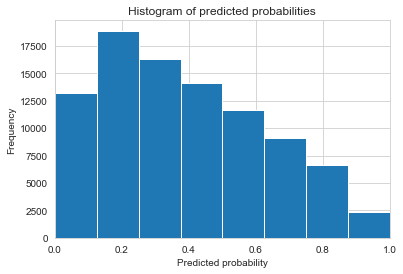

In [ ]:
#BASE
LogClassifier= LogisticRegression(random_state = 42)
start=time.time()
LogClassifier.fit(X_train_final, y_train)
end=time.time()
y_pred=LogClassifier.predict(X_test_final)
y_pred_prob=LogClassifier.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=LogClassifier.predict_proba(X_train_final)[:, 1]

print('Correct accuracy of the train set with Logistic Regression is:', round(LogClassifier.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with Logistic Regression is:', round(LogClassifier.score(X_test_final,y_test)*100,4),'%')
print('')
print('Total elapsed time is:', round(end-start,4),' sec')
#start=time.time()
#LogScores = cross_val_score(LogClassifier, X, y, cv=5)
#end=time.time()
#print('Logistic Regression score mean with cross val is:',round(np.mean(LogScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('Logistic Regression log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
print('Average precision-recall score: {0:0.4f}'.format(average_precision))


# histogram of predicted probabilities
plt.hist(y_pred_prob, bins=8)
plt.xlim(0, 1)
plt.title('Histogram of predicted probabilities')
plt.xlabel('Predicted probability')
plt.ylabel('Frequency')
plt.show()

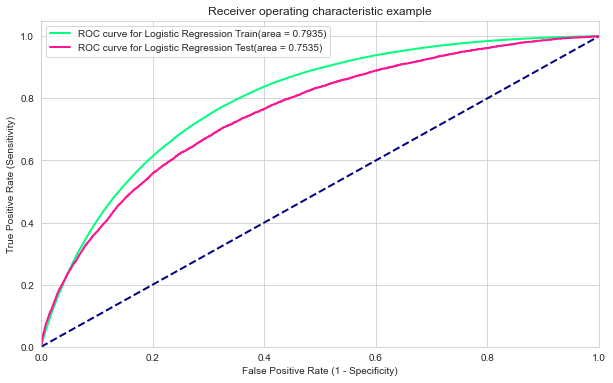

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Logistic Regression Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Logistic Regression Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('LG.png',dpi=300,bbox_inches='tight')
y_log=y_test
y_pred_log=y_pred_prob

ResultLG={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
# define a function that accepts a threshold and prints sensitivity and specificity
def evaluate_threshold(threshold):
    print('Sensitivity:', tpr[thresholds > threshold][-1])
    print('Specificity:', 1 - fpr[thresholds > threshold][-1])

In [ ]:
evaluate_threshold(0.1)

Sensitivity: 0.9844867125320383
Specificity: 0.11195058992703999


In [ ]:
# IMPORTANT: first argument is true values, second argument is predicted probabilities
print(metrics.roc_auc_score(y_test, y_pred))

0.6884178619692173


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.96      0.71      0.81     84841
           1       0.17      0.67      0.27      7413

    accuracy                           0.70     92254
   macro avg       0.56      0.69      0.54     92254
weighted avg       0.90      0.70      0.77     92254



In [ ]:
# Output importances
importance = LogClassifier.coef_[0]
imp_list = []
for i,v in enumerate(importance):
    imp_list.append((i, v))
sorted_list = sorted(imp_list, key=lambda x: x[1], reverse=True)
print('The top 10 Feature importances are:' '\n')
for f, i in sorted_list[:10]:
    print(f'{X_train_final.columns[f]}, Score: {round(i, 3)}')

In [ ]:
# Plot top ten importances
plt.bar(range(1, 11), [x[1] for x in sorted_list[:10]],
             tick_label=[x[0] for x in sorted_list[:10]],
             color = (0.2,0.5,0.7,0.6))
plt.title('Top Ten Feature Importances')
plt.xlabel('Feature Number')
plt.ylabel('Feature Importance Value')

# Logistic regression with hyperparameters

Correct accuracy of the train set with Logistic Regression is: 72.2601 %
Correct accuracy of the test set with Logistic Regression is: 70.4978 %

Total elapsed time is: 314.716  sec

Confusion Matrix is:
[[60087 24754]
 [ 2463  4950]]

Logistic Regression log_loss is: 10.1899

Average precision-recall score: 0.1380


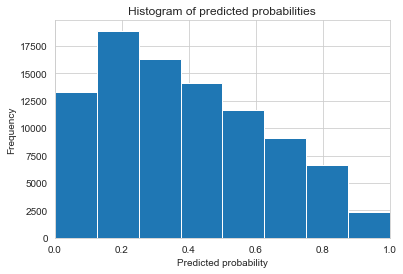

In [ ]:
#Tuned
LogClassifier= LogisticRegression(class_weight='balanced', dual=False,
                                  fit_intercept=True, intercept_scaling=1, max_iter=100,
                                  multi_class='multinomial', n_jobs=-1, penalty='l2', random_state=42,
                                  tol=0.0001, verbose=0, warm_start=False)
start=time.time()
LogClassifier.fit(X_train_final, y_train)
end=time.time()
y_pred=LogClassifier.predict(X_test_final)
y_pred_prob=LogClassifier.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=LogClassifier.predict_proba(X_train_final)[:, 1]

print('Correct accuracy of the train set with Logistic Regression is:', round(LogClassifier.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with Logistic Regression is:', round(LogClassifier.score(X_test_final,y_test)*100,4),'%')
print('')
print('Total elapsed time is:', round(end-start,4),' sec')
#start=time.time()
#LogScores = cross_val_score(LogClassifier, X, y, cv=5)
#end=time.time()
#print('Logistic Regression score mean with cross val is:',round(np.mean(LogScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('Logistic Regression log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
print('Average precision-recall score: {0:0.4f}'.format(average_precision))


# histogram of predicted probabilities
plt.hist(y_pred_prob, bins=8)
plt.xlim(0, 1)
plt.title('Histogram of predicted probabilities')
plt.xlabel('Predicted probability')
plt.ylabel('Frequency')
plt.show()

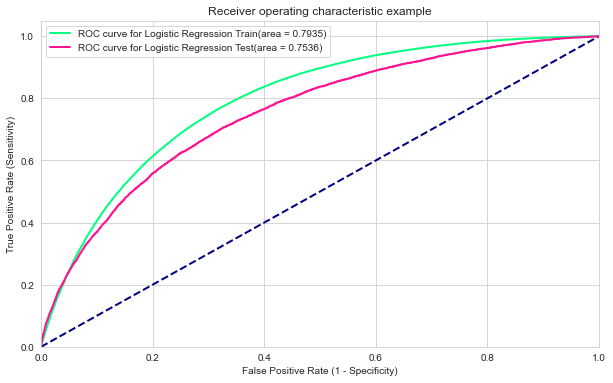

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Logistic Regression Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Logistic Regression Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('LG.png',dpi=300,bbox_inches='tight')
y_log=y_test
y_pred_log=y_pred_prob

ResultLG={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
# define a function that accepts a threshold and prints sensitivity and specificity
def evaluate_threshold(threshold):
    print('Sensitivity:', tpr[thresholds > threshold][-1])
    print('Specificity:', 1 - fpr[thresholds > threshold][-1])

In [ ]:
evaluate_threshold(0.1)

Sensitivity: 0.984351814380143
Specificity: 0.11305854480734545


In [ ]:
# IMPORTANT: first argument is true values, second argument is predicted probabilities
print(metrics.roc_auc_score(y_test, y_pred))

0.6879882711160069


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.96      0.71      0.82     84841
           1       0.17      0.67      0.27      7413

    accuracy                           0.70     92254
   macro avg       0.56      0.69      0.54     92254
weighted avg       0.90      0.70      0.77     92254



# Logistic regression with 20 important features

In [ ]:
# Output importances
importance = LogClassifier.coef_[0]
imp_list = []
for i,v in enumerate(importance):
    imp_list.append((i, v))
sorted_list = sorted(imp_list, key=lambda x: x[1], reverse=True)
print('The top 20 Feature importances are:' '\n')
for f, i in sorted_list[:20]:
    print(f'{X_train_final.columns[f]}, Score: {round(i, 3)}')

The top 20 Feature importances are:

ORGANIZATION_TYPE_Transport: type 3, Score: 0.31
ORGANIZATION_TYPE_Industry: type 1, Score: 0.247
ORGANIZATION_TYPE_Construction, Score: 0.193
ORGANIZATION_TYPE_Realtor, Score: 0.189
ORGANIZATION_TYPE_Legal Services, Score: 0.177
ORGANIZATION_TYPE_Restaurant, Score: 0.159
OCCUPATION_TYPE_Waiters/barmen staff, Score: 0.144
FLAG_DOCUMENT_3, Score: 0.137
OCCUPATION_TYPE_Low-skill Laborers, Score: 0.136
ORGANIZATION_TYPE_Self-employed, Score: 0.116
ORGANIZATION_TYPE_Industry: type 3, Score: 0.111
PREV_CNT_PAYMENT, Score: 0.096
ORGANIZATION_TYPE_Transport: type 4, Score: 0.094
WALLSMATERIAL_MODE_Others, Score: 0.094
DAYS_EMPLOYED, Score: 0.093
NAME_TYPE_SUITE_Children, Score: 0.091
ORGANIZATION_TYPE_Advertising, Score: 0.087
ORGANIZATION_TYPE_Mobile, Score: 0.087
ORGANIZATION_TYPE_Business Entity Type 3, Score: 0.085
ORGANIZATION_TYPE_Postal, Score: 0.084


Text(0, 0.5, 'Feature Importance Value')

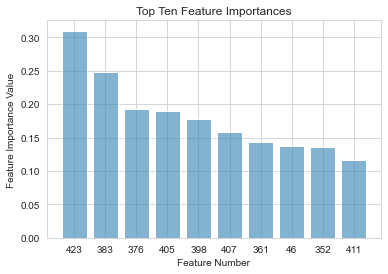

In [ ]:
# Plot top ten importances
plt.bar(range(1, 11), [x[1] for x in sorted_list[:10]],
             tick_label=[x[0] for x in sorted_list[:10]],
             color = (0.2,0.5,0.7,0.6))
plt.title('Top Ten Feature Importances')
plt.xlabel('Feature Number')
plt.ylabel('Feature Importance Value')

In [ ]:
feat = ['NAME_INCOME_TYPE_Working',
'NAME_EDUCATION_TYPE_Secondary / secondary special',
'CODE_GENDER_F',
'EXT_SOURCE_2',
'EMERGENCYSTATE_MODE_MISSING',
'NAME_FAMILY_STATUS_Married',
'FLAG_OWN_CAR_N',
'EXT_SOURCE_3',
'FLAG_OWN_CAR_Y',
'CODE_GENDER_M',
'POS_SK_DPD',
'BUREAU_LOAN_TYPES',
'HOUSETYPE_MODE_block of flats',
'EMERGENCYSTATE_MODE_No',
'PREV_CODE_REJECT_REASON_HC',
'OCCUPATION_TYPE_Laborers',
'ORGANIZATION_TYPE_Business Entity Type 3',
'PREV_NAME_CLIENT_TYPE_New',
'REGION_RATING_CLIENT',
'EXT_SOURCE_1']

In [ ]:
X_train_final_i = X_train_final.loc[:,feat]
X_test_final_i = X_test_final.loc[:,feat]

Correct accuracy of the train set with Logistic Regression is: 69.1334 %
Correct accuracy of the test set with Logistic Regression is: 68.397 %

Total elapsed time is: 13.4595  sec

Confusion Matrix is:
[[58211 26630]
 [ 2525  4888]]

Logistic Regression log_loss is: 10.9155

Average precision-recall score: 0.1296


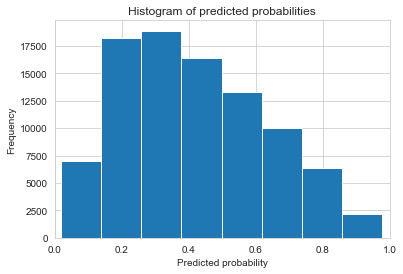

In [ ]:
#with 20 features
LogClassifier= LogisticRegression(class_weight='balanced', dual=False,
                                  fit_intercept=True, intercept_scaling=1, max_iter=100,
                                  multi_class='multinomial', n_jobs=-1, penalty='l2', random_state=42,
                                  tol=0.0001, verbose=0, warm_start=False)
start=time.time()
LogClassifier.fit(X_train_final_i, y_train)
end=time.time()
y_pred=LogClassifier.predict(X_test_final_i)
y_pred_prob=LogClassifier.predict_proba(X_test_final_i)[:, 1]
y_train_pred_prob=LogClassifier.predict_proba(X_train_final_i)[:, 1]

print('Correct accuracy of the train set with Logistic Regression is:', round(LogClassifier.score(X_train_final_i,y_train)*100,4),'%')
print('Correct accuracy of the test set with Logistic Regression is:', round(LogClassifier.score(X_test_final_i,y_test)*100,4),'%')
print('')
print('Total elapsed time is:', round(end-start,4),' sec')
#start=time.time()
#LogScores = cross_val_score(LogClassifier, X, y, cv=5)
#end=time.time()
#print('Logistic Regression score mean with cross val is:',round(np.mean(LogScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('Logistic Regression log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
print('Average precision-recall score: {0:0.4f}'.format(average_precision))


# histogram of predicted probabilities
plt.hist(y_pred_prob, bins=8)
plt.xlim(0, 1)
plt.title('Histogram of predicted probabilities')
plt.xlabel('Predicted probability')
plt.ylabel('Frequency')
plt.show()

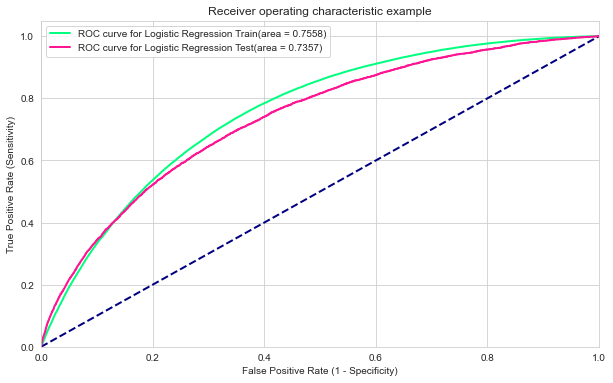

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Logistic Regression Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Logistic Regression Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('LG.png',dpi=300,bbox_inches='tight')
y_log=y_test
y_pred_log=y_pred_prob

ResultLG={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
# define a function that accepts a threshold and prints sensitivity and specificity
def evaluate_threshold(threshold):
    print('Sensitivity:', tpr[thresholds > threshold][-1])
    print('Specificity:', 1 - fpr[thresholds > threshold][-1])

In [ ]:
evaluate_threshold(0.1)

Sensitivity: 0.9956832591393497
Specificity: 0.036079254134203986


In [ ]:
# IMPORTANT: first argument is true values, second argument is predicted probabilities
print(metrics.roc_auc_score(y_test, y_pred))

0.6727504531122885


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.96      0.69      0.80     84841
           1       0.16      0.66      0.25      7413

    accuracy                           0.68     92254
   macro avg       0.56      0.67      0.53     92254
weighted avg       0.89      0.68      0.76     92254



# Decision Tree

Total elapsed time is: 143.8615  sec
Correct accuracy of the train set with Decision Tree Classifier is: 100.0 %
Correct accuracy of the test set with Decision Tree Classifier is: 84.56 %


Confusion Matrix is:
[[76693  8148]
 [ 6096  1317]]

Decision Tree log_loss is: 5.3329

Average precision-recall score: 0.0908


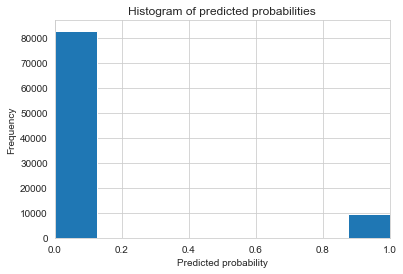

In [ ]:
#base
DTClassifier= DecisionTreeClassifier(random_state = 42)
start=time.time()
DTClassifier.fit(X_train_final, y_train)
end=time.time()
y_pred=DTClassifier.predict(X_test_final)
y_pred_prob=DTClassifier.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=DTClassifier.predict_proba(X_train_final)[:, 1]
print('Total elapsed time is:', round(end-start,4),' sec')
print('Correct accuracy of the train set with Decision Tree Classifier is:', round(DTClassifier.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with Decision Tree Classifier is:', round(DTClassifier.score(X_test_final,y_test)*100,4),'%')
print('')
#start=time.time()
#DTScores = cross_val_score(DTClassifier, X, y, cv=5)
#end=time.time()
#print('Decision Tree score mean with cross val is:',round(np.mean(DTScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('Decision Tree log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
print('Average precision-recall score: {0:0.4f}'.format(average_precision))

plt.hist(y_pred_prob, bins=8)
plt.xlim(0, 1)
plt.title('Histogram of predicted probabilities')
plt.xlabel('Predicted probability')
plt.ylabel('Frequency')
plt.show()

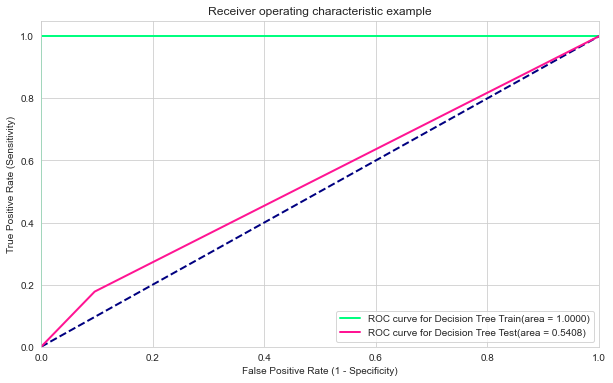

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
roc_aucTrain=roc_auc
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Decision Tree Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Decision Tree Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('RF1.png',dpi=300,bbox_inches='tight')
y_RF=y_test
y_pred_RF=y_pred_prob

ResultRF1={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
print(metrics.roc_auc_score(y_test, y_pred))

0.5408111970404648


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.93      0.90      0.92     84841
           1       0.14      0.18      0.16      7413

    accuracy                           0.85     92254
   macro avg       0.53      0.54      0.54     92254
weighted avg       0.86      0.85      0.85     92254



In [ ]:
# Output importances
importance = DTClassifier.feature_importances_
imp_list = []
for i,v in enumerate(importance):
    imp_list.append((i, v))
sorted_list = sorted(imp_list, key=lambda x: x[1], reverse=True)
print('The top 20 Feature importances are:' '\n')
for f, i in sorted_list[:20]:
    print(f'{X_train_final.columns[f]}, Score: {round(i, 3)}')

The top 20 Feature importances are:

NAME_INCOME_TYPE_Working, Score: 0.232
NAME_EDUCATION_TYPE_Secondary / secondary special, Score: 0.129
CODE_GENDER_F, Score: 0.065
EXT_SOURCE_2, Score: 0.051
EMERGENCYSTATE_MODE_MISSING, Score: 0.048
NAME_FAMILY_STATUS_Married, Score: 0.025
FLAG_OWN_CAR_N, Score: 0.023
EXT_SOURCE_3, Score: 0.02
FLAG_OWN_CAR_Y, Score: 0.014
CODE_GENDER_M, Score: 0.014
POS_SK_DPD, Score: 0.011
BUREAU_LOAN_TYPES, Score: 0.01
HOUSETYPE_MODE_block of flats, Score: 0.01
EMERGENCYSTATE_MODE_No, Score: 0.009
PREV_CODE_REJECT_REASON_HC, Score: 0.008
OCCUPATION_TYPE_Laborers, Score: 0.007
ORGANIZATION_TYPE_Business Entity Type 3, Score: 0.007
PREV_NAME_CLIENT_TYPE_New, Score: 0.007
REGION_RATING_CLIENT, Score: 0.005
EXT_SOURCE_1, Score: 0.005


Text(0, 0.5, 'Feature Importance Value')

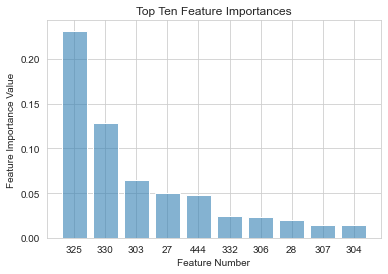

In [ ]:
# Plot top ten importances
plt.bar(range(1, 11), [x[1] for x in sorted_list[:10]],
             tick_label=[x[0] for x in sorted_list[:10]],
             color = (0.2,0.5,0.7,0.6))
plt.title('Top Ten Feature Importances')
plt.xlabel('Feature Number')
plt.ylabel('Feature Importance Value')

# Decision Tree with hyperparameter tuning

Total elapsed time is: 18.4435  sec
Correct accuracy of the train set with Decision Tree Classifier is: 79.0076 %
Correct accuracy of the test set with Decision Tree Classifier is: 74.4044 %


Confusion Matrix is:
[[65702 19139]
 [ 4474  2939]]

Decision Tree log_loss is: 8.8406

Average precision-recall score: 0.1013


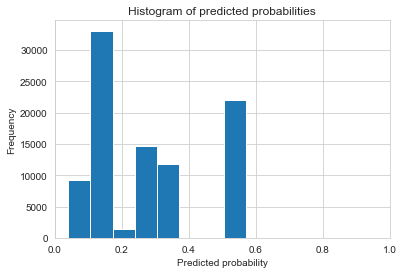

In [ ]:
#tuned
DTClassifier= DecisionTreeClassifier(criterion='gini',
                                 random_state=42,
                                 max_depth=5,
                                 min_samples_leaf=50,
                                 min_samples_split=50)
start=time.time()
DTClassifier.fit(X_train_final, y_train)
end=time.time()
y_pred=DTClassifier.predict(X_test_final)
y_pred_prob=DTClassifier.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=DTClassifier.predict_proba(X_train_final)[:, 1]
print('Total elapsed time is:', round(end-start,4),' sec')
print('Correct accuracy of the train set with Decision Tree Classifier is:', round(DTClassifier.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with Decision Tree Classifier is:', round(DTClassifier.score(X_test_final,y_test)*100,4),'%')
print('')
#start=time.time()
#DTScores = cross_val_score(DTClassifier, X, y, cv=5)
#end=time.time()
#print('Decision Tree score mean with cross val is:',round(np.mean(DTScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('Decision Tree log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
print('Average precision-recall score: {0:0.4f}'.format(average_precision))

plt.hist(y_pred_prob, bins=8)
plt.xlim(0, 1)
plt.title('Histogram of predicted probabilities')
plt.xlabel('Predicted probability')
plt.ylabel('Frequency')
plt.show()

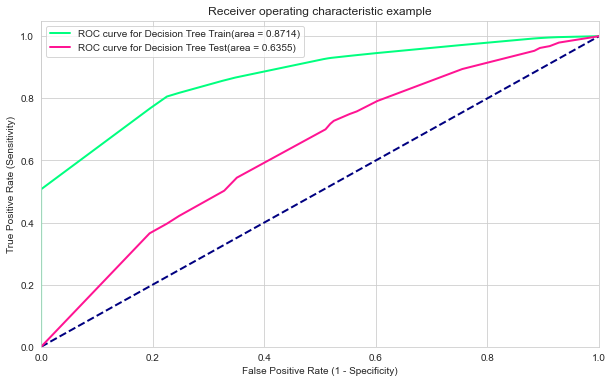

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
roc_aucTrain=roc_auc
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Decision Tree Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Decision Tree Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('RF1.png',dpi=300,bbox_inches='tight')
y_RF=y_test
y_pred_RF=y_pred_prob

ResultRF1={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
print(metrics.roc_auc_score(y_test, y_pred))

0.5854394913688564


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.94      0.77      0.85     84841
           1       0.13      0.40      0.20      7413

    accuracy                           0.74     92254
   macro avg       0.53      0.59      0.52     92254
weighted avg       0.87      0.74      0.80     92254



# RandomForest

Total elapsed time is: 253.8002  sec
Correct accuracy of the train set with Random Forest Classifier is: 99.9997 %
Correct accuracy of the test set with Random Forest Classifier is: 91.9657 %


Confusion Matrix is:
[[84835     6]
 [ 7406     7]]

Random Forest log_loss is: 2.775

Average precision-recall score: 0.0808


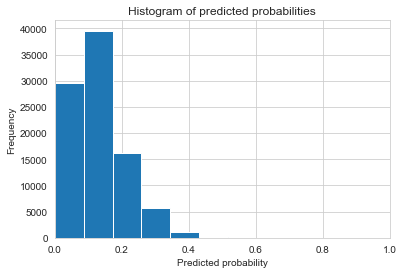

In [ ]:
RandClassifier= RandomForestClassifier(random_state=42)
start=time.time()
RandClassifier.fit(X_train_final, y_train)
end=time.time()
y_pred=RandClassifier.predict(X_test_final)
y_pred_prob=RandClassifier.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=RandClassifier.predict_proba(X_train_final)[:, 1]
print('Total elapsed time is:', round(end-start,4),' sec')
print('Correct accuracy of the train set with Random Forest Classifier is:', round(RandClassifier.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with Random Forest Classifier is:', round(RandClassifier.score(X_test_final,y_test)*100,4),'%')
print('')
#start=time.time()
#RandScores = cross_val_score(RandClassifier, X, y, cv=5)
#end=time.time()
#print('Random Forest score mean with cross val is:',round(np.mean(RandScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('Random Forest log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
print('Average precision-recall score: {0:0.4f}'.format(average_precision))

plt.hist(y_pred_prob, bins=8)
plt.xlim(0, 1)
plt.title('Histogram of predicted probabilities')
plt.xlabel('Predicted probability')
plt.ylabel('Frequency')
plt.show()

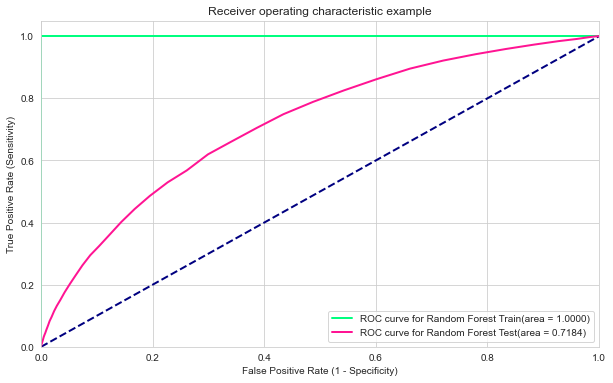

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
roc_aucTrain=roc_auc
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Random Forest Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Random Forest Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('RF1.png',dpi=300,bbox_inches='tight')
y_RF=y_test
y_pred_RF=y_pred_prob

ResultRF1={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
print(metrics.roc_auc_score(y_test, y_pred))

0.5004367832694963


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.92      1.00      0.96     84841
           1       0.54      0.00      0.00      7413

    accuracy                           0.92     92254
   macro avg       0.73      0.50      0.48     92254
weighted avg       0.89      0.92      0.88     92254



In [ ]:
# Output importances
importance = RandClassifier.feature_importances_
imp_list = []
for i,v in enumerate(importance):
    imp_list.append((i, v))
sorted_list = sorted(imp_list, key=lambda x: x[1], reverse=True)
print('The top 10 Feature importances are:' '\n')
for f, i in sorted_list[:10]:
    print(f'{X_train_final.columns[f]}, Score: {round(i, 3)}')

The top 10 Feature importances are:

CODE_GENDER_M, Score: 0.031
NAME_EDUCATION_TYPE_Secondary / secondary special, Score: 0.028
CODE_GENDER_F, Score: 0.027
NAME_INCOME_TYPE_Working, Score: 0.027
EMERGENCYSTATE_MODE_MISSING, Score: 0.024
FLAG_OWN_CAR_Y, Score: 0.023
EXT_SOURCE_2, Score: 0.022
FLAG_OWN_CAR_N, Score: 0.021
NAME_EDUCATION_TYPE_Higher education, Score: 0.02
HOUSETYPE_MODE_MISSING, Score: 0.019


Text(0, 0.5, 'Feature Importance Value')

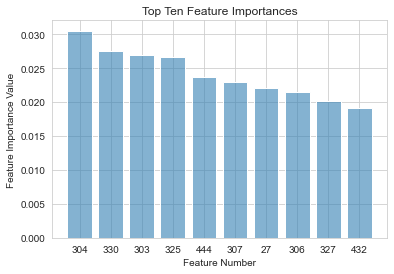

In [ ]:
# Plot top ten importances
plt.bar(range(1, 11), [x[1] for x in sorted_list[:10]],
             tick_label=[x[0] for x in sorted_list[:10]],
             color = (0.2,0.5,0.7,0.6))
plt.title('Top Ten Feature Importances')
plt.xlabel('Feature Number')
plt.ylabel('Feature Importance Value')

# Random Forest with hyperparameter tuning

Total elapsed time is: 129.1654  sec
Correct accuracy of the train set with Random Forest Classifier is: 93.7289 %
Correct accuracy of the test set with Random Forest Classifier is: 90.2996 %


Confusion Matrix is:
[[82667  2174]
 [ 6775   638]]

Random Forest log_loss is: 3.3504

Average precision-recall score: 0.0930


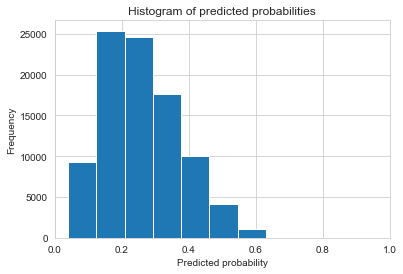

In [ ]:
RandClassifier= RandomForestClassifier(n_estimators=100,max_depth=10,min_samples_leaf=2,random_state=42)
start=time.time()
RandClassifier.fit(X_train_final, y_train)
end=time.time()
y_pred=RandClassifier.predict(X_test_final)
y_pred_prob=RandClassifier.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=RandClassifier.predict_proba(X_train_final)[:, 1]
print('Total elapsed time is:', round(end-start,4),' sec')
print('Correct accuracy of the train set with Random Forest Classifier is:', round(RandClassifier.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with Random Forest Classifier is:', round(RandClassifier.score(X_test_final,y_test)*100,4),'%')
print('')
#start=time.time()
#RandScores = cross_val_score(RandClassifier, X, y, cv=5)
#end=time.time()
#print('Random Forest score mean with cross val is:',round(np.mean(RandScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('Random Forest log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
print('Average precision-recall score: {0:0.4f}'.format(average_precision))

plt.hist(y_pred_prob, bins=8)
plt.xlim(0, 1)
plt.title('Histogram of predicted probabilities')
plt.xlabel('Predicted probability')
plt.ylabel('Frequency')
plt.show()

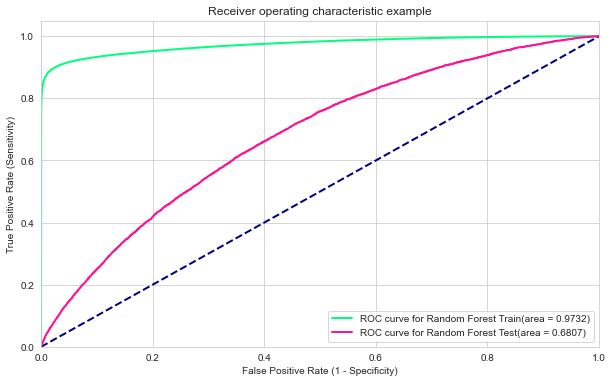

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
roc_aucTrain=roc_auc
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Random Forest Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Random Forest Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('RF1.png',dpi=300,bbox_inches='tight')
y_RF=y_test
y_pred_RF=y_pred_prob

ResultRF1={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
print(metrics.roc_auc_score(y_test, y_pred))

0.5302203088068185


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.92      0.97      0.95     84841
           1       0.23      0.09      0.12      7413

    accuracy                           0.90     92254
   macro avg       0.58      0.53      0.54     92254
weighted avg       0.87      0.90      0.88     92254



# Gradient Boosting Classifier

In [ ]:
GradClassifier = GradientBoostingClassifier(random_state=42)
start=time.time()
GradClassifier.fit(X_train_final, y_train)
end=time.time()
y_pred=GradClassifier.predict(X_test_final)
y_pred_prob=GradClassifier.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=GradClassifier.predict_proba(X_train_final)[:, 1]
print('Total elapsed time is:', round(end-start,4),' sec')
print('Correct accuracy of the train set with Gradient Boosting Classifier is:', round(GradClassifier.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with Gradient Boosting Classifier is:', round(GradClassifier.score(X_test_final,y_test)*100,4),'%')
print('')
#start=time.time()
#GradScores = cross_val_score(GradClassifier, X, y, cv=5)
#end=time.time()
#print('Gradient boosting score Mean with cross val is:',round(np.mean(GradScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
#print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('GradClassifier log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
average_precision = average_precision_score(y_test, y_pred)
print('Average precision-recall score: {0:0.4f}'.format(average_precision))

Total elapsed time is: 2415.6669  sec
Correct accuracy of the train set with Gradient Boosting Classifier is: 95.3691 %
Correct accuracy of the test set with Gradient Boosting Classifier is: 91.9451 %

Confusion Matrix is:
[[84793    48]
 [ 7383    30]]

GradClassifier log_loss is: 2.7821

Average precision-recall score: 0.0816


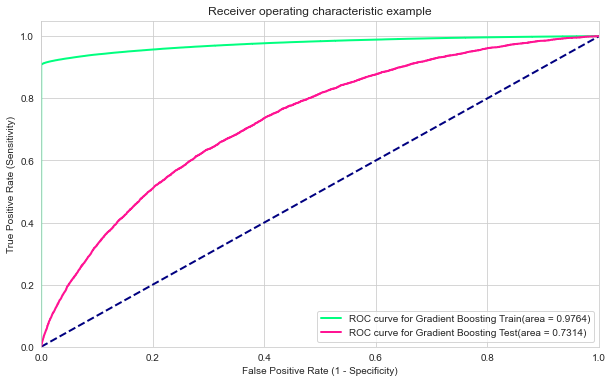

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
roc_aucTrain=roc_auc
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Gradient Boosting Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Gradient Boosting Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('GB1.png',dpi=300,bbox_inches='tight')
y_GB=y_test
y_pred_GB=y_pred_prob

ResultGB1={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
print(metrics.roc_auc_score(y_test, y_pred))

0.5017405901813305


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.92      1.00      0.96     84841
           1       0.38      0.00      0.01      7413

    accuracy                           0.92     92254
   macro avg       0.65      0.50      0.48     92254
weighted avg       0.88      0.92      0.88     92254



In [ ]:
# Output importances
importance = GradClassifier.feature_importances_
imp_list = []
for i,v in enumerate(importance):
    imp_list.append((i, v))
sorted_list = sorted(imp_list, key=lambda x: x[1], reverse=True)
print('The top 10 Feature importances are:' '\n')
for f, i in sorted_list[:10]:
    print(f'{X_train_final.columns[f]}, Score: {round(i, 3)}')

The top 10 Feature importances are:

NAME_INCOME_TYPE_Working, Score: 0.134
NAME_EDUCATION_TYPE_Secondary / secondary special, Score: 0.099
FLAG_OWN_CAR_Y, Score: 0.066
EXT_SOURCE_2, Score: 0.047
CODE_GENDER_F, Score: 0.044
EMERGENCYSTATE_MODE_MISSING, Score: 0.042
NAME_FAMILY_STATUS_Married, Score: 0.04
EMERGENCYSTATE_MODE_No, Score: 0.039
FLAG_PHONE, Score: 0.038
WEEKDAY_APPR_PROCESS_START_MONDAY, Score: 0.03


Text(0, 0.5, 'Feature Importance Value')

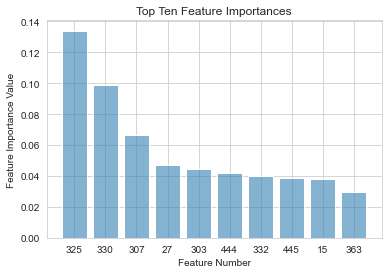

In [ ]:
# Plot top ten importances
plt.bar(range(1, 11), [x[1] for x in sorted_list[:10]],
             tick_label=[x[0] for x in sorted_list[:10]],
             color = (0.2,0.5,0.7,0.6))
plt.title('Top Ten Feature Importances')
plt.xlabel('Feature Number')
plt.ylabel('Feature Importance Value')

# Gradient Boosting with hyperparameter tuning

In [ ]:
GradClassifier = GradientBoostingClassifier(learning_rate=0.1, n_estimators=60,max_depth=9,max_features='sqrt',
                                            subsample=0.8, random_state=42,min_samples_leaf=60, min_samples_split=1800)
start=time.time()
GradClassifier.fit(X_train_final, y_train)
end=time.time()
y_pred=GradClassifier.predict(X_test_final)
y_pred_prob=GradClassifier.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=GradClassifier.predict_proba(X_train_final)[:, 1]
print('Total elapsed time is:', round(end-start,4),' sec')
print('Correct accuracy of the train set with Gradient Boosting Classifier is:', round(GradClassifier.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with Gradient Boosting Classifier is:', round(GradClassifier.score(X_test_final,y_test)*100,4),'%')
print('')
#start=time.time()
#GradScores = cross_val_score(GradClassifier, X, y, cv=5)
#end=time.time()
#print('Gradient boosting score Mean with cross val is:',round(np.mean(GradScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
#print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('GradClassifier log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
average_precision = average_precision_score(y_test, y_pred)
print('Average precision-recall score: {0:0.4f}'.format(average_precision))

Total elapsed time is: 200.896  sec
Correct accuracy of the train set with Gradient Boosting Classifier is: 95.3764 %
Correct accuracy of the test set with Gradient Boosting Classifier is: 91.8085 %

Confusion Matrix is:
[[84521   320]
 [ 7237   176]]

GradClassifier log_loss is: 2.8293

Average precision-recall score: 0.0869


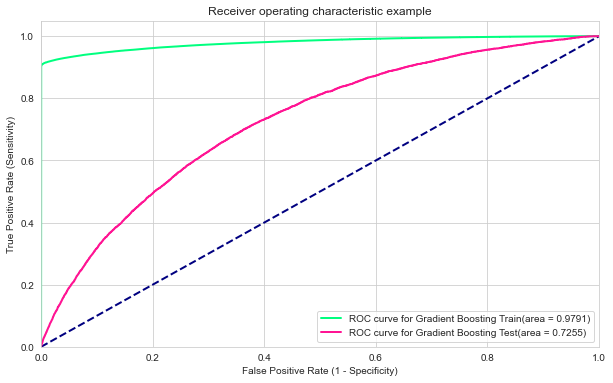

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
roc_aucTrain=roc_auc
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Gradient Boosting Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Gradient Boosting Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('GB1.png',dpi=300,bbox_inches='tight')
y_GB=y_test
y_pred_GB=y_pred_prob

ResultGB1={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
print(metrics.roc_auc_score(y_test, y_pred))

0.5099851567194595


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.92      1.00      0.96     84841
           1       0.35      0.02      0.04      7413

    accuracy                           0.92     92254
   macro avg       0.64      0.51      0.50     92254
weighted avg       0.88      0.92      0.88     92254



# Naive Bayes

In [ ]:
NBClassifier = GaussianNB()
start=time.time()
NBClassifier.fit(X_train_final, y_train)
end=time.time()
y_pred=NBClassifier.predict(X_test_final)
y_pred_prob=NBClassifier.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=NBClassifier.predict_proba(X_train_final)[:, 1]
print('Total elapsed time is:', round(end-start,4),' sec')
print('Correct accuracy of the train set with Naive Bayes Classifier is:', round(NBClassifier.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with Naive Bayes Classifier is:', round(NBClassifier.score(X_test_final,y_test)*100,4),'%')
print('')
#start=time.time()
#NBScores = cross_val_score(NBClassifier, X, y, cv=5)
#end=time.time()
#print('Naive Bayes score Mean with cross val is:',round(np.mean(NBScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
#print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('Naive Bayes log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
average_precision = average_precision_score(y_test, y_pred)
print('Average precision-recall score: {0:0.4f}'.format(average_precision))

Total elapsed time is: 3.144  sec
Correct accuracy of the train set with Naive Bayes Classifier is: 53.0256 %
Correct accuracy of the test set with Naive Bayes Classifier is: 16.111 %

Confusion Matrix is:
[[ 7880 76961]
 [  430  6983]]

Naive Bayes log_loss is: 28.9749

Average precision-recall score: 0.0830


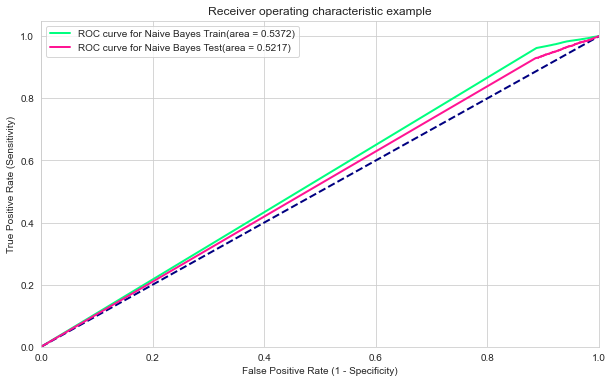

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
roc_aucTrain=roc_auc
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Naive Bayes Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Naive Bayes Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('NB1.png',dpi=300,bbox_inches='tight')
y_NB=y_test
y_pred_NB=y_pred_prob

ResultNB1={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
print(metrics.roc_auc_score(y_test, y_pred))

0.5174367082829715


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.95      0.09      0.17     84841
           1       0.08      0.94      0.15      7413

    accuracy                           0.16     92254
   macro avg       0.52      0.52      0.16     92254
weighted avg       0.88      0.16      0.17     92254



# Naive bayes with hyperparameter tuning

In [ ]:
NBClassifier = GaussianNB('C':[0.8],'gamma':[0.3])
start=time.time()
NBClassifier.fit(X_train_final, y_train)
end=time.time()
y_pred=NBClassifier.predict(X_test_final)
y_pred_prob=NBClassifier.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=NBClassifier.predict_proba(X_train_final)[:, 1]
print('Total elapsed time is:', round(end-start,4),' sec')
print('Correct accuracy of the train set with Naive Bayes Classifier is:', round(NBClassifier.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with Naive Bayes Classifier is:', round(NBClassifier.score(X_test_final,y_test)*100,4),'%')
print('')
#start=time.time()
#NBScores = cross_val_score(NBClassifier, X, y, cv=5)
#end=time.time()
#print('Naive Bayes score Mean with cross val is:',round(np.mean(NBScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
#print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('Naive Bayes log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
average_precision = average_precision_score(y_test, y_pred)
print('Average precision-recall score: {0:0.4f}'.format(average_precision))

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
roc_aucTrain=roc_auc
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for Naive Bayes Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for Naive Bayes Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('NB1.png',dpi=300,bbox_inches='tight')
y_NB=y_test
y_pred_NB=y_pred_prob

ResultNB1={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
print(metrics.roc_auc_score(y_test, y_pred))

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

# XGBoost

In [ ]:
xgb_cv = XGBClassifier(n_estimators=100)
start=time.time()
xgb_cv.fit(X_train_final, y_train)
end=time.time()
y_pred=xgb_cv.predict(X_test_final)
y_pred_prob=xgb_cv.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=xgb_cv.predict_proba(X_train_final)[:, 1]
print('Total elapsed time is:', round(end-start,4),' sec')
print('Correct accuracy of the train set with XGBoost Classifier is:', round(xgb_cv.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with XGBoost Classifier is:', round(xgb_cv.score(X_test_final,y_test)*100,4),'%')
print('')
#start=time.time()
#XGBScores = cross_val_score(xgb_cv, X, y, cv=5)
#end=time.time()
#print('XGBoost score Mean with cross val is:',round(np.mean(XGBScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
#print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('XGBoost log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
average_precision = average_precision_score(y_test, y_pred)
print('Average precision-recall score: {0:0.4f}'.format(average_precision))

Total elapsed time is: 234.2551  sec
Correct accuracy of the train set with XGBoost Classifier is: 96.0474 %
Correct accuracy of the test set with XGBoost Classifier is: 91.8768 %

Confusion Matrix is:
[[84356   485]
 [ 7009   404]]

XGBoost log_loss is: 2.8057

Average precision-recall score: 0.1007


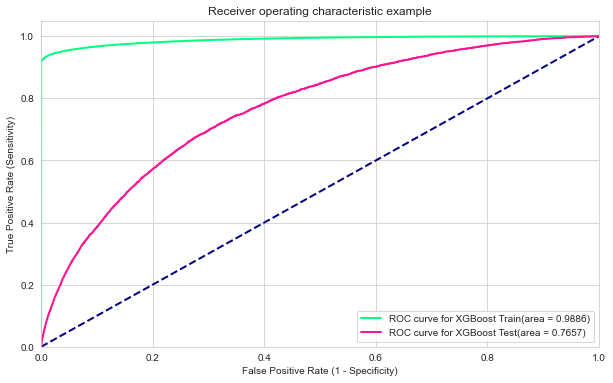

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
roc_aucTrain=roc_auc
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for XGBoost Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for XGBoost Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('XGB1.png',dpi=300,bbox_inches='tight')
y_XGB=y_test
y_pred_XGB=y_pred_prob

ResultXGB1={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
print(metrics.roc_auc_score(y_test, y_pred))

0.5243911388267471


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.92      0.99      0.96     84841
           1       0.45      0.05      0.10      7413

    accuracy                           0.92     92254
   macro avg       0.69      0.52      0.53     92254
weighted avg       0.89      0.92      0.89     92254



In [ ]:
# Output importances
importance = xgb_cv.feature_importances_
imp_list = []
for i,v in enumerate(importance):
    imp_list.append((i, v))
sorted_list = sorted(imp_list, key=lambda x: x[1], reverse=True)
print('The top 10 Feature importances are:' '\n')
for f, i in sorted_list[:10]:
    print(f'{X_train_final.columns[f]}, Score: {round(i, 3)}')

The top 10 Feature importances are:

WALLSMATERIAL_MODE_MISSING, Score: 0.08900000154972076
EMERGENCYSTATE_MODE_No, Score: 0.05700000002980232
WEEKDAY_APPR_PROCESS_START_MONDAY, Score: 0.04699999839067459
FLAG_OWN_CAR_N, Score: 0.04399999976158142
WALLSMATERIAL_MODE_Panel, Score: 0.04100000113248825
WEEKDAY_APPR_PROCESS_START_TUESDAY, Score: 0.03799999877810478
WEEKDAY_APPR_PROCESS_START_FRIDAY, Score: 0.035999998450279236
NAME_INCOME_TYPE_Working, Score: 0.035999998450279236
FLAG_DOCUMENT_3, Score: 0.03500000014901161
WEEKDAY_APPR_PROCESS_START_THURSDAY, Score: 0.03200000151991844


Text(0, 0.5, 'Feature Importance Value')

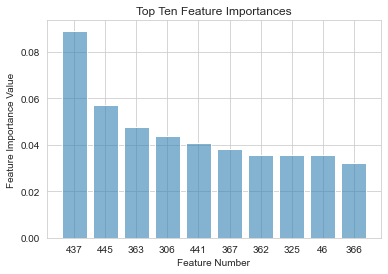

In [ ]:
# Plot top ten importances
plt.bar(range(1, 11), [x[1] for x in sorted_list[:10]],
             tick_label=[x[0] for x in sorted_list[:10]],
             color = (0.2,0.5,0.7,0.6))
plt.title('Top Ten Feature Importances')
plt.xlabel('Feature Number')
plt.ylabel('Feature Importance Value')

# XGBoost with hyperparameter tuning

In [ ]:
xgb_cv = XGBClassifier(max_depth=5, learning_rate=0.01, n_estimators=100, gamma=0,
                        min_child_weight=1, subsample=0.8, colsample_bytree=0.8, reg_alpha=0.005)
start=time.time()
xgb_cv.fit(X_train_final, y_train)
end=time.time()
y_pred=xgb_cv.predict(X_test_final)
y_pred_prob=xgb_cv.predict_proba(X_test_final)[:, 1]
y_train_pred_prob=xgb_cv.predict_proba(X_train_final)[:, 1]
print('Total elapsed time is:', round(end-start,4),' sec')
print('Correct accuracy of the train set with XGBoost Classifier is:', round(xgb_cv.score(X_train_final,y_train)*100,4),'%')
print('Correct accuracy of the test set with XGBoost Classifier is:', round(xgb_cv.score(X_test_final,y_test)*100,4),'%')
print('')
#start=time.time()
#XGBScores = cross_val_score(xgb_cv, X, y, cv=5)
#end=time.time()
#print('XGBoost score Mean with cross val is:',round(np.mean(XGBScores)*100,4),'%')
#print('Total elapsed time is:', round(end-start,4),' sec')
#print('')
print('Confusion Matrix is:')
print(confusion_matrix(y_test, y_pred))
print('')
print('XGBoost log_loss is:',round(log_loss(y_test, y_pred),4))
average_precision = average_precision_score(y_test, y_pred)
print('')
average_precision = average_precision_score(y_test, y_pred)
print('Average precision-recall score: {0:0.4f}'.format(average_precision))

Total elapsed time is: 216.5371  sec
Correct accuracy of the train set with XGBoost Classifier is: 90.8992 %
Correct accuracy of the test set with XGBoost Classifier is: 90.4297 %

Confusion Matrix is:
[[82861  1980]
 [ 6849   564]]

XGBoost log_loss is: 3.3055

Average precision-recall score: 0.0911


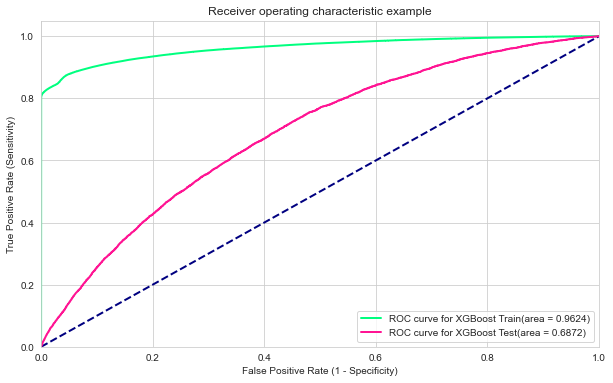

<Figure size 432x288 with 0 Axes>

In [ ]:
fpr, tpr, thresholds=roc_curve(y_train, y_train_pred_prob)
roc_auc = auc(fpr, tpr)
plt.figure(figsize=(10,6))
lw = 2
roc_aucTrain=roc_auc
plt.plot(fpr, tpr, color='springgreen',lw=lw, label='ROC curve for XGBoost Train(area = %0.4f)' % roc_auc)
plt.plot([0, 1], [0, 1],lw=lw, color='navy', linestyle='--')
roc_aucTrain=roc_auc
fpr, tpr, thresholds=roc_curve(y_test, y_pred_prob)
roc_auc = auc(fpr, tpr)

plt.plot(fpr, tpr, color='deeppink',lw=lw, label='ROC curve for XGBoost Test(area = %0.4f)' % roc_auc)

plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate (1 - Specificity)')
plt.ylabel('True Positive Rate (Sensitivity)')
plt.title('Receiver operating characteristic example')
plt.legend(loc="lower right")
plt.grid(True)

plt.legend(loc=0)
plt.show()
plt.savefig('XGB1.png',dpi=300,bbox_inches='tight')
y_XGB=y_test
y_pred_XGB=y_pred_prob

ResultXGB1={'AUC Train':roc_aucTrain, 'AUC Test':roc_auc,'Average Precision Score':average_precision,
          'Log Loss Score':round(log_loss(y_test, y_pred),4),'Elapsed Time':round(end-start,4) }

In [ ]:
print(metrics.roc_auc_score(y_test, y_pred))

0.5263723923291347


In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     84841
           1       0.22      0.08      0.11      7413

    accuracy                           0.90     92254
   macro avg       0.57      0.53      0.53     92254
weighted avg       0.87      0.90      0.88     92254

